# IDS Assignment Part 2 - <font color="red"><h7>Deadline: 23/01/2023 23:59</h7></font>
This is the second part of the assignment in IDS 2022/2023. 
Please use this Jupyter notebook to work on the questions posed in the assignment. When you are done, upload the notebook in Moodle at the designated activity. In addition to the _Jupyter notebook_, please submit _one zip-file_ containing your screenshots for Question 7. 

Give your commented Python code and answers in the corresponding provided cells. Make sure to answer all questions in a clear and explicit manner and discuss your outputs. _Please do not change the general structure of this notebook_. You can, however, add additional markdown or code cells if necessary. <b>Please DO NOT CLEAR THE OUTPUT of the notebook you are submitting! </b>

<font color="red"> *Please make sure to include the names and matriculation numbers of all group members in the slot provided below.* </font> If a name or a student id is missing, the student will not receive any points.

Hint 1: While working on the assignment, you will get a better understanding of the dataset. Feel free to generate additional results and visualizations to support your answers. For example, this might be useful regarding data modification, data simplification, or output interpretation. <font color="red">Ensure that all your claims are supported.</font>

Hint 2: <font color="red">Plan your time wisely. </font> A few parts of this assignment may take some time to run. It might be necessary to consider time management when you plan your group work. Also, do not attempt to upload your assignment at the last minute before the deadline. This often does not work, and you will miss the deadline. Late submissions will not be considered.

Hint 3: RWTHmoodle allows multiple submissions, with every new submission overwriting the previous one. <b>Partial submissions are therefore possible and encouraged. </b> This might be helpful in case of technical issues with RWTHMoodle, which may occur close to the deadline.

<font color="red"><b>Student Names and IDs:
    
    1. Ruizhang Zhou 405527
    
    2. Robin Jaschke 395359
    
    3.

## Question 1: Preprocessing (20 points)

In [1]:
import pandas as pd
import numpy as np

### Sklearn
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.impute import KNNImputer

In this question, we consider a dataset documenting the Ski Resorts in Europe (**ski_resorts.csv**).
Each row contains some information about the Ski resort.
You can find a short description for each column:

| Column | Description |
| ------ | ----------- |
| Resort | The name of the ski & snowboard resort. |
| Country | The country in which the resort is located. |
| HighestPoint | The highest mountain point at the ski resort.   |
| LowestPoint | The lowest possible point to ski at the ski resort.  |
| DayPassPriceAdult | The price shows what it costs for 1 adult for 1 day in the main season in Euro. |
| BeginnerSlope | The total amount of “beginner” slopes in kilometer at the resort. “Beginner slopes” contains “children”, “blue” and, “green” slopes. |
| IntermediateSlope | The total amount of “intermediate” slopes in kilometer at the resort. “Intermediate slopes” contains “red” slopes. |
| DifficultSlope | The total amount of “difficult” slopes in kilometer at the resort. “Difficult slopes” contains “black”, “advanced”, and ”expert” slopes. |
| TotalSlope | The sum of “beginner slopes” + “intermediate slopes” + “difficult slopes” |
| Snowparks | Does the resort have one or more snowparks, or not? |
| NightSki | Does the resort offer skiing on illuminated slopes? |
| SurfaceLifts | The amount of lifts in this category: T-bar, Sunkidslift, Rope lifts, and people mower. |
| ChairLifts | The total amount of chairlifts. |
| GondolaLifts | The amount of lifts in this category: Gondola, Train lifts, Funicular, Combined gondola and chairlifts, Helicopter lifts, Snowcats, and Aerial tramways. |
| TotalLifts | The sum of “surface lifts etc” + “gondola etc” + “chairlifts etc.” |
| LiftCapacity | How many passengers can the lift system at the ski resort mowe in one hour? |
| SnowCannons  |The total amount of snow cannons at the ski resort.|

### a) Loading the Data and Initial Quality Investigation (2.5pts)

#### **a(i)** 
Load the dataset into a dataframe `df`. <font color='red'>Use the first column as index for your dataframe</font>. Ensure that the index is valid, that is, it should not contain any duplicate entries. 



**In the subsequent questions, only modify the dataframe `df` if explicitly requested. However, you can always create working copies.**

In [2]:
# All files from the zip archive have to be unpacked into the folder "datasets" inside the working directory.
df = pd.read_csv('./datasets/ski_resorts.csv', sep=',', index_col=0)

# Check if index contains duplicates.
no_duplicate_indices = df.shape[0] == len(df.index.unique())
if no_duplicate_indices:
    print('The index does not contain duplicates.')
else:
    print('Warning: The index contains duplicates.')
assert no_duplicate_indices

The index does not contain duplicates.


#### **a(ii)** 
Show the data types of the dataframe columns as well as the first 5 rows. On the first sight, are there any data type problems (e.g., numerical columns having a non-numerical data type)?



In [3]:
# Show data types.
display(df.dtypes)

# Show the first 5 rows.
display(df.head(5))

Resort                object
Country               object
HighestPoint         float64
LowestPoint          float64
DayPassPriceAdult    float64
BeginnerSlope        float64
IntermediateSlope      int64
DifficultSlope       float64
TotalSlope             int64
Snowparks             object
NightSki              object
SurfaceLifts         float64
ChairLifts             int64
GondolaLifts         float64
TotalLifts             int64
LiftCapacity         float64
SnowCannons          float64
dtype: object

,Resort,Country,HighestPoint,LowestPoint,DayPassPriceAdult,BeginnerSlope,IntermediateSlope,DifficultSlope,TotalSlope,Snowparks,NightSki,SurfaceLifts,ChairLifts,GondolaLifts,TotalLifts,LiftCapacity,SnowCannons
1,Alpendorf (Ski amedé),Austria,1980.0,740.0,52.0,30.0,81,4.0,115,Yes,No,22.0,16,11.0,49,75398.0,600.0
2,Soldeu-Pas de la Casa/​Grau Roig/​El Tarter/​C...,Andorra,2640.0,1710.0,47.0,100.0,77,33.0,210,Yes,Yes,37.0,28,7.0,72,99017.0,1032.0
3,Oberau (Wildschönau),Austria,1130.0,900.0,30.0,1.0,0,1.0,2,No,No,2.0,0,0.0,2,1932.0,0.0
4,Dachstein West,Austria,1620.0,780.0,42.0,15.0,33,3.0,51,Yes,Yes,25.0,8,3.0,36,32938.0,163.0
5,Rosa Khutor,Southern Russia,2320.0,940.0,22.0,30.0,26,21.0,77,Yes,No,6.0,11,10.0,27,49228.0,450.0


In [4]:
# Check if columns are encoded as float when they could be an int.
for col in df.columns:
    if df[col].dtype == 'float64':
        if all([number.is_integer() for number in df[col] if not pd.isna(number)]):
            print(f'Column "{col}" contains only integer values, but is encoded as float.')

Column "HighestPoint" contains only integer values, but is encoded as float.
Column "LowestPoint" contains only integer values, but is encoded as float.
Column "DayPassPriceAdult" contains only integer values, but is encoded as float.
Column "BeginnerSlope" contains only integer values, but is encoded as float.
Column "DifficultSlope" contains only integer values, but is encoded as float.
Column "SurfaceLifts" contains only integer values, but is encoded as float.
Column "GondolaLifts" contains only integer values, but is encoded as float.
Column "LiftCapacity" contains only integer values, but is encoded as float.
Column "SnowCannons" contains only integer values, but is encoded as float.


**Your Answer:**

There are the following potential data type problems:

**1.** The columns indicated by the output of the above cell are encoded as floats, but could be integer values:
- The columns "HighestPoint", "LowestPoint", "DayPassPriceAdult" and "LiftCapacity" could contain non-integer values according to their meaning, but the present dataset only contains integer values.
- The remaining columns (number of lifts / slopes / snow cannons) must be integer values by their definition.

The reason for this is that, by default, pandas encodes missing values using the NumPy-NaN value which is encoded as a float.

**2.** The columns "Snowparks" and "NightSki" are boolean values by their definition, but are encoded as strings.

**3.** The column "Country" can be encoded as a categorical value instead of a string.

#### **a(iii)** 
To improve performance and memory usage (in particular for large datasets) it is important to use **categorical** columns whenever suitable.
Are there any categorical column candidates? Explain your answer. \
Afterward, convert the column(s) in `df` into categorical column(s).

In [5]:
display(df['Country'].value_counts())

Austria                   89
France                    83
Switzerland               61
Italy                     44
Germany                   24
Norway                    10
Spain                      8
Denmark                    8
Sweden                     6
Andorra                    5
Slovakia                   5
Slovenia                   4
United Kingdom             4
Bulgaria                   4
Southern Russia            4
Finland                    3
Poland                     2
Czech Republic             2
Romania                    2
Lithuania                  1
Liechtenstein              1
Serbia                     1
Greece                     1
Siberia                    1
Bosnia and Herzegovina     1
Ukraine                    1
Netherlands                1
Name: Country, dtype: int64

In [6]:
df['Country'] = df['Country'].astype("category")

display(df['Country'])

1              Austria
2              Andorra
3              Austria
4              Austria
5      Southern Russia
            ...       
372             France
373              Italy
374              Italy
375              Italy
376            Austria
Name: Country, Length: 376, dtype: category
Categories (27, object): ['Andorra', 'Austria', 'Bosnia and Herzegovina', 'Bulgaria', ..., 'Sweden', 'Switzerland', 'Ukraine', 'United Kingdom']

**Your Answer:**

The column "Country" contains names of countries.
Thus, the possible values are limited to a finite set.
As the column is encoded with strings, it can be converted to a categorical column.

### b) Handling Missing Values & Encoding (17.5pts)

In the following task, you can assume that every NAN entry in the dataframe is actually a missing value. This can partially be justified by the fact that pandas did not have problems inferring the "proper" datatypes (e.g., a string indicating a missing number in a number column would result in pandas parsing an object column) and your subsequent check of the data types. Therefore, you can use `df.isna()` as a proxy indicator for missing values.

#### **b(i)** 
Simply discarding missing entries is usually not a good idea. Therefore, you should first analyze the number of missing values and check for patterns of missing values. 

To this end, compute the following statistics on missing values:
1. How many entries does the dataframe have? (To relate this to the number of entries missing)
2. How many missing values do we have? What is the ratio i.e., "number of missing values"/"number of entries of df"?
3. How many rows have at least a single missing value?
4. Count the number of missing values per column.
5. Count the number of missing values per row and aggregate them - i.e., show the number of rows that suffer from x missing values.
6. What do you observe? Are there any rows containing missing values for the same set of columns? Can you identify potential patterns?


In [7]:
# 1. Number data frame of entries.
number_entries = df.size

print(f'The data set has {number_entries} entries.')

The data set has 6392 entries.


In [8]:
# 2. Number of missing values and corresponding ratio.
number_entries_nan = sum([
    sum([pd.isna(value) for value in row])
    for row in df.values
])

print(f'The data set has {number_entries_nan} missing values.\nTherefore, the corresponding ratio is {round(number_entries_nan / number_entries, 6)*100}%.')

The data set has 87 missing values.
Therefore, the corresponding ratio is 1.3611%.


In [9]:
# 3. Number of rows with at least one missing value.
number_rows_with_nan = sum([
    any([pd.isna(value) for value in row])
    for row in df.values
])

print(f'{number_rows_with_nan} rows have at least one missing value.')

45 rows have at least one missing value.


In [10]:
# 4. Number of missing values per column.
missing_values_per_col = pd.Series({
    col: sum([pd.isna(value) for value in df[col]])
    for col in df.columns
})

print('Number of missing values per column:')
display(missing_values_per_col)

Number of missing values per column:


Resort                0
Country               0
HighestPoint         13
LowestPoint           3
DayPassPriceAdult    17
BeginnerSlope         8
IntermediateSlope     0
DifficultSlope        8
TotalSlope            0
Snowparks             0
NightSki              0
SurfaceLifts          6
ChairLifts            0
GondolaLifts          7
TotalLifts            0
LiftCapacity         17
SnowCannons           8
dtype: int64

In [11]:
# 5. Number of missing values per row.
missing_values_per_row = pd.Series({
    i: sum([pd.isna(value) for value in row])
    for i, row in df.iterrows()
})

print('Number of missing values per row:')
display(missing_values_per_row)

print('Aggregated number of missing values per row:\n(The right value represents the number of rows with as many missing values as shown by the left number.)')
display(missing_values_per_row.value_counts())

Number of missing values per row:


1      0
2      0
3      0
4      0
5      0
      ..
372    1
373    0
374    0
375    0
376    0
Length: 376, dtype: int64

Aggregated number of missing values per row:
(The right value represents the number of rows with as many missing values as shown by the left number.)


0    331
1     35
6      8
2      2
dtype: int64

In [12]:
# 6. Observe patterns for missing values per row.
missing_columns_per_row = pd.Series({
    i: str([col for col in df.columns if pd.isna(row[col])])
    for i, row in df.iterrows()
})

print('List of missing columns per row:')
display(missing_columns_per_row)

print('Number of rows (right) with a specific pattern of missing columns (left):')
display(missing_columns_per_row.value_counts())

List of missing columns per row:


1                    []
2                    []
3                    []
4                    []
5                    []
             ...       
372    ['SurfaceLifts']
373                  []
374                  []
375                  []
376                  []
Length: 376, dtype: object

Number of rows (right) with a specific pattern of missing columns (left):


[]                                                                                                         331
['DayPassPriceAdult']                                                                                        8
['LiftCapacity']                                                                                             8
['HighestPoint', 'DayPassPriceAdult', 'BeginnerSlope', 'DifficultSlope', 'LiftCapacity', 'SnowCannons']      8
['GondolaLifts']                                                                                             7
['HighestPoint']                                                                                             5
['SurfaceLifts']                                                                                             4
['LowestPoint']                                                                                              3
['SurfaceLifts', 'LiftCapacity']                                                                             1
[

**Your answer:**

It can be observed, that the 8 rows with the highest number of missing values (which is 6) are all missing the same information: 'HighestPoint', 'DayPassPriceAdult', 'BeginnerSlope', 'DifficultSlope', 'LiftCapacity', and 'SnowCannons'.

#### **b(ii)**
For the next step:

1. Transform the categorical column(s) you identified in a(iii) into one-hot encoding format. 
2. Transform the columns "Snowparks" and "NightSki" in `df` into boolean data type, where "Yes" should be `True` and "No" should be `False`

In the end, the original categorical column(s) should still be there. Additionally, there should be x number (x is the number of unique values) of one-hot encoding columns for each categorical column. Use the following naming convention for the new columns "{name of the categorical column}_{unique value for that column}" Also, make sure the columns "Snowparks" and "NightSki" are boolean type in the end.
Lastly, print the top five rows of the resulting dataframe.

*Hint: You can use the pd.get_dummies() function from pandas for the first transformation*

In [13]:
one_hot_countries = pd.get_dummies(df['Country'], prefix='Country_')
df[one_hot_countries.columns] = one_hot_countries

In [14]:
for col in ['Snowparks', 'NightSki']:
    df[col] = df[col] == 'Yes'

In [15]:
display(df.head(5))

,Resort,Country,HighestPoint,LowestPoint,DayPassPriceAdult,BeginnerSlope,IntermediateSlope,DifficultSlope,TotalSlope,Snowparks,...,Country__Serbia,Country__Siberia,Country__Slovakia,Country__Slovenia,Country__Southern Russia,Country__Spain,Country__Sweden,Country__Switzerland,Country__Ukraine,Country__United Kingdom
1,Alpendorf (Ski amedé),Austria,1980.0,740.0,52.0,30.0,81,4.0,115,True,...,0,0,0,0,0,0,0,0,0,0
2,Soldeu-Pas de la Casa/​Grau Roig/​El Tarter/​C...,Andorra,2640.0,1710.0,47.0,100.0,77,33.0,210,True,...,0,0,0,0,0,0,0,0,0,0
3,Oberau (Wildschönau),Austria,1130.0,900.0,30.0,1.0,0,1.0,2,False,...,0,0,0,0,0,0,0,0,0,0
4,Dachstein West,Austria,1620.0,780.0,42.0,15.0,33,3.0,51,True,...,0,0,0,0,0,0,0,0,0,0
5,Rosa Khutor,Southern Russia,2320.0,940.0,22.0,30.0,26,21.0,77,True,...,0,0,0,0,1,0,0,0,0,0


#### **b(iii)** 
The previous analysis in b(i) showed that there are missing values in the 'SurfaceLifts' and 'GondolaLifts' columns.\
How would you impute these values? \
Motivate your approach and apply it to `df`.

*Hint: Remember the semantics of the columns. Also, carefully assert your assumptions.*


In [16]:
# Check all lift values of rows with missing values.
lift_columns = ['SurfaceLifts', 'ChairLifts', 'GondolaLifts', 'TotalLifts']

print('Index    [SurfaceLifts, ChairLifts, GondolaLifts, TotalLifts]')
display(pd.Series({
    i: row.values
    for i, row in df[lift_columns].iterrows()
    if any(row.isna())
}))

Index    [SurfaceLifts, ChairLifts, GondolaLifts, TotalLifts]


23     [nan, 13.0, 4.0, 38.0]
50      [nan, 7.0, 0.0, 29.0]
105      [2.0, 2.0, nan, 6.0]
119     [nan, 4.0, 2.0, 16.0]
126    [11.0, 0.0, nan, 15.0]
189      [5.0, 3.0, nan, 8.0]
201      [8.0, 1.0, nan, 9.0]
204     [nan, 5.0, 0.0, 15.0]
208      [3.0, 2.0, nan, 8.0]
250      [3.0, 1.0, nan, 4.0]
275     [nan, 7.0, 8.0, 47.0]
298     [8.0, 2.0, nan, 12.0]
372    [nan, 35.0, 7.0, 71.0]
dtype: object

**Your Answer:**

The columns containing the number of lifts are dependent on each other, as the sum of all values for specific lifts must sum up to the value for the total number of lifts.

By looking at these values for rows with missing information about lifts (above code cell), we can see that at most one value is missing.
Thus, the missing values can be filled by calculating the remaining difference from the sum to match the total number of lifts.

In [17]:
df_lifts = df[lift_columns]

lift_columns_specific = ['SurfaceLifts', 'ChairLifts', 'GondolaLifts']

for col in lift_columns_specific:
    series = pd.Series({
        i: row[col] if pd.notna(row[col]) else row['TotalLifts'] - sum([row[s_col] for s_col in lift_columns_specific if s_col != col])
        for i, row in df.iterrows()
    })

    df[col] = series


#### **b(iv)**
Impute the rest of the missing values using the knn-imputation method. To this end, apply the following steps:
1. Create a working copy `df_tmp` of your updated `df`.
2. For simplicity, drop the non-numerical columns (i.e., not of types integer or floats), which also inlcude the one-hot encoded and the boolean columns* you created earlier.
3. Normalize the data in `df_tmp` (e.g., Standard score normalization). If the features have very different scales, knn can become very biased.
4. Impute the missing values considering six neighbors.
5. Invert the transformation applied upfront to enable more meaningful and intuitive visualizations.
6. Append the columns you dropped in step 2.
 
In the end, `df` should not contain missing values and have all the columns.

\*Note that by dropping the columns we lose the information of countries and the two boolean attributes ("Snowparks" and "NightSki") when imputing the missing values, which might be crucial for inferencing values such as the price for a ski pass. In practice, one should try to find if there are correlations before deciding whether to drop the columns or not.
We drop the columns here to make the following steps easier because we only have to deal with numerical columns.

*Hint: Be careful with the indices of your dataframes.*


In [18]:
# Copy data frame and drop categorical and boolean values.
dropped_cols = ['Resort'] + ['Snowparks', 'NightSki'] + [col for col in df.columns if 'Country' in col]
df_tmp = df.drop(dropped_cols, axis=1)

In [19]:
# Perform standard score normalization.
scaler = StandardScaler()
scaler.fit(df_tmp)

df_tmp = pd.DataFrame(data=scaler.transform(df_tmp), columns=df_tmp.columns, index=df_tmp.index)

In [20]:
# Perform knn with k = 6.
imputer = KNNImputer(n_neighbors=6)
df_tmp = pd.DataFrame(data=imputer.fit_transform(df_tmp), columns=df_tmp.columns, index=df_tmp.index)

In [21]:
# Revert scaling.
df_tmp = pd.DataFrame(data=scaler.inverse_transform(df_tmp), columns=df_tmp.columns, index=df_tmp.index)

In [22]:
# Append previously dropped columns.
df = pd.concat([df_tmp, df[dropped_cols]], axis=1)

In [23]:
display(df)

assert df.isna().sum().sum() == 0

,HighestPoint,LowestPoint,DayPassPriceAdult,BeginnerSlope,IntermediateSlope,DifficultSlope,TotalSlope,SurfaceLifts,ChairLifts,GondolaLifts,...,Country__Serbia,Country__Siberia,Country__Slovakia,Country__Slovenia,Country__Southern Russia,Country__Spain,Country__Sweden,Country__Switzerland,Country__Ukraine,Country__United Kingdom
1,1980.0,740.0,52.0,30.0,81.0,4.0,115.0,22.0,16.0,11.0,...,0,0,0,0,0,0,0,0,0,0
2,2640.0,1710.0,47.0,100.0,77.0,33.0,210.0,37.0,28.0,7.0,...,0,0,0,0,0,0,0,0,0,0
3,1130.0,900.0,30.0,1.0,0.0,1.0,2.0,2.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
4,1620.0,780.0,42.0,15.0,33.0,3.0,51.0,25.0,8.0,3.0,...,0,0,0,0,0,0,0,0,0,0
5,2320.0,940.0,22.0,30.0,26.0,21.0,77.0,6.0,11.0,10.0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372,2749.0,1372.0,48.0,96.0,220.0,84.0,400.0,29.0,35.0,7.0,...,0,0,0,0,0,0,0,0,0,0
373,2749.0,1372.0,48.0,96.0,220.0,84.0,400.0,29.0,35.0,7.0,...,0,0,0,0,0,0,0,0,0,0
374,3275.0,1212.0,43.0,23.0,94.0,15.0,132.0,9.0,9.0,12.0,...,0,0,0,0,0,0,0,0,0,0
375,3275.0,1212.0,43.0,23.0,94.0,15.0,132.0,9.0,9.0,12.0,...,0,0,0,0,0,0,0,0,0,0


## Question 2: Visualization (13 points)

In this task, you will analyze the data using different means of visualization.

Start with the following preprocessed and integrated dataframe `df_v`. \
Note that it has a similar structure to the dataframe that you should obtain from the previous task, however, the values have been modified.

In [24]:
import pandas as pd
import plotly.express as px
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt
import seaborn as sns

In [25]:
df_v = pd.read_csv("./datasets/ski_resorts_visual.csv", index_col=0)

### **a) (3pts)** 
To start the visual analysis, make a Scatter plot matrix to visually check if there are any correlations between the numerical attributes.

*Hint: You can use the scatter_matrix from pandas.plotting or pairplot from seaborn to make the plot.*


In [26]:
numerical_cols = [col for col in df_v.columns if df_v.dtypes[col] == 'int64']

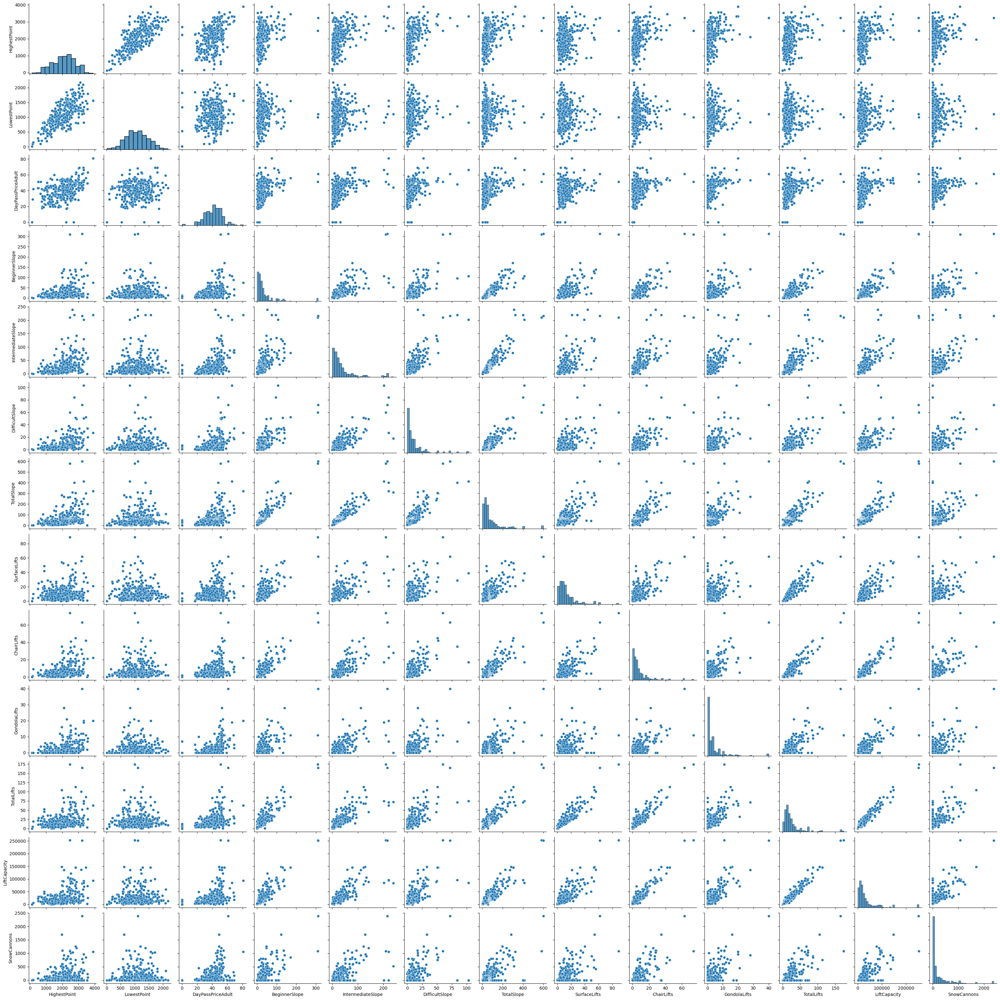

In [27]:
grid = sns.pairplot(df_v)

fig, axes = grid.fig, grid.axes
fig.set_facecolor("white")

### **b) (3pts)**
Another way to detect correlation is to calculate the Pearson correlation coefficient. Calculate the correlation matrix for the numerical data and visualize the matrix using a heatmap. 
Briefly discuss your findings from the heatmap and the scatter plot you created in 2(a).

Make sure to annotate the heatmap with the values of the correlation.

*Hint: You can use the heatmap function from seaborn to make the plot.*

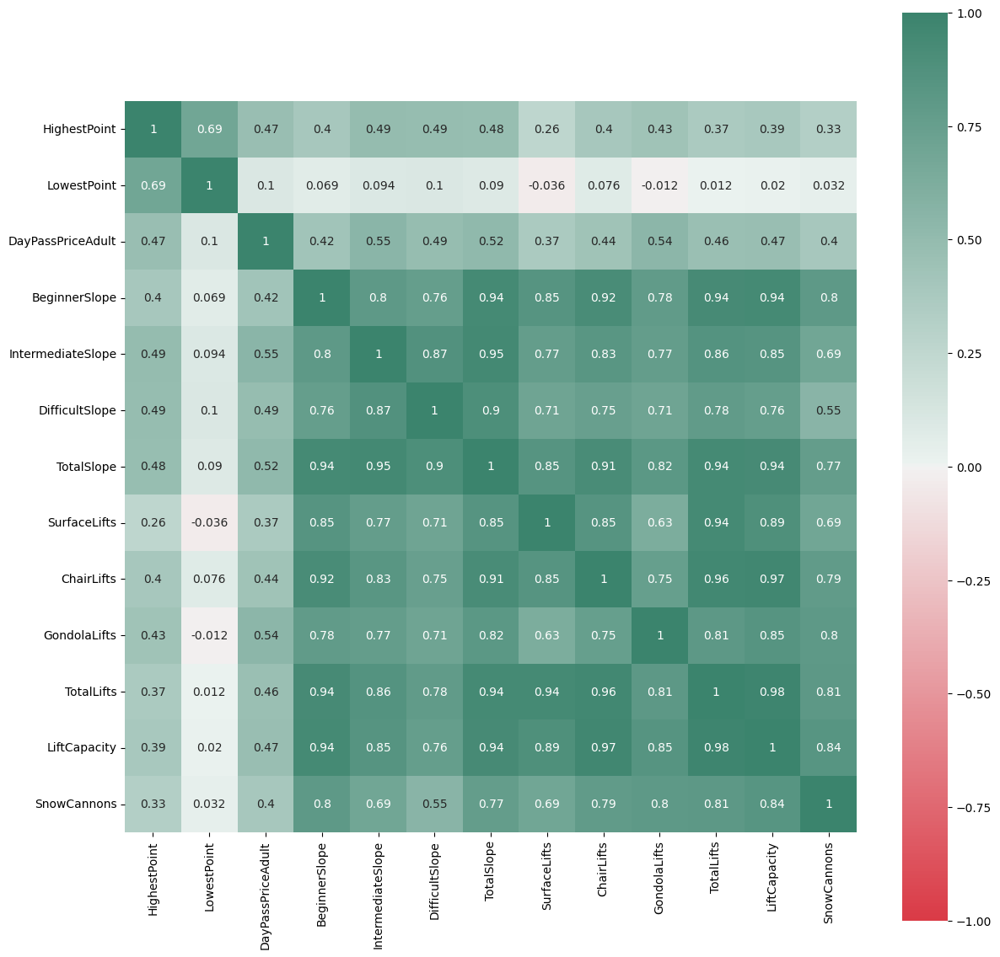

In [28]:
correlation_matrix = df_v[numerical_cols].corr()

fig, ax = plt.subplots(figsize=(14,14))
fig.set_facecolor('white')

heatmap = sns.heatmap(correlation_matrix,
                vmin=-1,
                vmax=1,
                cmap=sns.diverging_palette(10, 160, as_cmap=True),
                ax=ax,
                square=True,
                annot=correlation_matrix)

**Discussion:**

There is a positive correlation between most of the values:
1. The number of slopes per difficulty each positively correlate with the total number of slopes. This is expected, as a higher number of slopes of a specific difficulty implies a higher number of total slopes.\
The same statement is true for the number of lifts and their capacity.
2. There is also a high positive correlation between the number of slopes, lifts and snow cannons.\
This could be explained by reasoning that a larger ski resort with a higher number of slopes requires a higher number of lifts and snow cannons.
3. These attributes (related to the size of the resort) all have a slightly lower but still positive correlation with the price and the highest point.

Only the lowest point seems to have little to no correlation with the other values.

### **c) (4pts)** 
We now want to have an overview of the attribute "TotalSlope" aggregated by different levels of hierarchy (Europe -> Country -> Resort). It seems that a tree map is suitable for this purpose.

Make a tree map where
- the root node represents Europe.
- the child nodes of Europe are countries.
- the child nodes of each country are the ski resorts.
- the size of the rectangles is determined by the attribute "TotalSlope".

Also, use the tree map to find out
1. The sum of TotalSlopes of a country, list the top five countries and the corresponding values.
2. The max value of TotalSlope of the five countries you identified in 1.

*Hint: You can use the treemap function from plotly.express.*

In [29]:
fig = px.treemap(df_v, path=[px.Constant('Europe'), 'Country', 'Resort'], values='TotalSlope')
display(fig)

**Your answer:**

1\.Top five countries concerning the sum of the total number of slopes:

1. France: 12546 slopes
2. Austria: 7005 slopes
3. Switzerland: 5710 slopes
4. Italy: 3742 slopes
5. Andorra: 723 slopes
    
2\. The maximum value of slopes per country is 12546 (France) while the maximum value of slopes per resort is 600 ("Les 3 Vallées" in France).


### **d) (3pts)** 

An alternative to a tree map is a sunburst plot, the principle is similar to a tree map. 

Recall from the lecture that:
- Each ring is a different level of the hierarchy
- Each segment of a ring belongs to one categorical value
- The size of a segment is either divided proportionally to a value

Now, we would like to have an overview of the attribute "TotalLifts" aggregated by different level of hierarchy.

Make a sunburst plot where
- the first hierarchy(ring) is "Country"
- the second hierarchy(ring) is "Snowparks" (whether the resort has snowparks)
- the third hierarchy(ring) is "Resort"
- the size of the segments is determined by the attribute "TotalLifts".

Then, briefly discuss your findings from the plot.

*Hint: You can use the sunburst function from plotly.express.*

In [30]:
fig = px.sunburst(df_v, path=[px.Constant('Europe'), 'Country', 'Snowparks', 'Resort'], values='TotalLifts')
display(fig)

**Your answer:**

The sizes of the country categories have similar proportions as the rectangles in the tree map representing the number of slopes.\
This finding matches the previous observation that the numbers of lifts and slopes have positive correlation. (Question 2 b)

It can further be observed, that a large share of resorts in countries with high numbers of total lifts have snow parks.

## Question 3 - Frequent Item Sets and Association Rules (15 points)

In [31]:
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules as arule

### A real online retail transaction data set of two years.

Data Set Information:
This Retail dataset contains all the transactions occurring for a UK-based and registered, non-store online retail between 01/12/2009 and 09/12/2011.The company mainly sells unique all-occasion gift ware. Many customers of the company are wholesalers.

Attribute Information:
- Invoice: Invoice number. Nominal. A 6-digit integral number is uniquely assigned to each transaction. If the number starts with 'C' it refers to a canceled transaction.
- StockCode: Product (item) code. Nominal. A 5-digit integral number uniquely assigned to each distinct product.
- Description: Product (item) name. Nominal.
- Quantity: The quantities of each product (item) per transaction. Numeric.
- InvoiceDate: Invoice date and time. Numeric. The day and time when a transaction was generated.
- Price: Unit price. Numeric. Product price per unit in sterling (£).
- CustomerID: Customer number. Nominal. A 5-digit integral number is uniquely assigned to each customer. This number has postfix 'n'.
- Country: Country name. Nominal. The name of the country where a customer resides.

### a) Loading, exploring and preprocessing the dataset (4 pts)

#### **a(i)** 
Load the data from `retail.csv` and save it under the variable `retail_df`. Display the first few lines of the dataframe.

In [32]:
retail_df = pd.read_csv('./datasets/retail.csv', sep=',')
display(retail_df.head())

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01/12/2010 08:26,2.55,178500,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,01/12/2010 08:26,3.39,178500,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01/12/2010 08:26,2.75,178500,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01/12/2010 08:26,3.39,178500,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01/12/2010 08:26,3.39,178500,United Kingdom


#### **a(ii)** 
To get to know the dataset, do the following:

- Show the number of rows in the dataset.
- Show the number of unique customers.
- Show the number of unique product names.
- Show the number of unique invoices.
- Show the number and the list of all the countries where the customers reside.

In [33]:
print(f'Number of rows in the dataset: {retail_df.shape[0]}')

print(f'Number of unique customers: {len(retail_df["CustomerID"].unique())}')

print(f'Number of unique product names: {len(retail_df["StockCode"].unique())}')

print(f'Number of unique invoices: {len(retail_df["Invoice"].unique())}')

countries = retail_df["Country"].unique()
print(f'The customers reside in these {len(countries)} countries:\n{countries}')

retail_df_orig = retail_df.copy()

Number of rows in the dataset: 406525
Number of unique customers: 4367
Number of unique product names: 3684
Number of unique invoices: 22177
The customers reside in these 35 countries:
['United Kingdom' 'France' 'Australia' 'Netherlands' 'Germany' 'Norway'
 'EIRE' 'Switzerland' 'Spain' 'Poland' 'Portugal' 'Italy' 'Belgium'
 'Lithuania' 'Japan' 'Iceland' 'Channel Islands' 'Denmark' 'Cyprus'
 'Sweden' 'Austria' 'Israel' 'Finland' 'Greece' 'Singapore' 'Lebanon'
 'United Arab Emirates' 'Saudi Arabia' 'Czech Republic' 'Canada' 'Brazil'
 'USA' 'Bahrain' 'Malta' 'RSA']


#### **a(iii)** 
You are interested in analyzing itemsets that are frequently purchased together. Before continuing with that task, you have to make sure that the data are fit for such analysis. 1) More precisely, you want to make sure that there are no missing values in the data. 2) Moreover, you want to ensure that each item's name in the "Description" is consistent. E.g., you want "Description" values such as " coffee black", "coffee &nbsp;black", " coffee black &nbsp;", etc. to be mapped to the same value (e.g. "coffee black"). 3) Last but not least, you want to remove transactions that were canceled. Such transactions correspond to rows where the invoice number starts with letter 'C'.

Apply these preprocessing steps to the dataset `retail_df` and apply them on the dataframe itself (e.g. set inplace=True).

In [34]:
### 1) Drop all rows with missing values.
n = retail_df.shape[0]
retail_df.dropna(inplace=True, axis=0)
print(f'{n - retail_df.shape[0]} rows with NaN values dropped.')

### 2) Assign the same description to all rows with the same stock code.

## Function removes trailing/leading/double whitespaces.
def remove_ws(d: str) -> str:
    # Split string by whitespaces.
    words = [word for word in d.split(' ')]
    # Join all words again with a single whitespace.
    return ' '.join([word for word in words if len(word) > 0])

## Create a dictionary to save the first occurring description of each item.
descriptions = dict()

## Create a dictionary to save all alternative descriptions for a stock code.
alternative_descriptions = dict()

## Function takes a stock code and maps it to the first description found.
def get_desc(c: int, d: str) -> str:
    # Remove whitespaces of description.
    d_ws_rm = remove_ws(d)
    # Check if the code has already occurred.
    found = descriptions.get(c)
    if found is not None:
        # If has found description is not the same, save it in the corresponding dict.
        if found != d_ws_rm and d_ws_rm not in alternative_descriptions[c]:
            alternative_descriptions[c].append(d_ws_rm)
        # Return the existing description.
        return found
    else:
        # Save description as first found.
        descriptions[c] = d_ws_rm
        alternative_descriptions[c] = [d_ws_rm]

        return d_ws_rm

n_codes = len(retail_df["StockCode"].unique())
n_desc_before = len(retail_df["Description"].unique())
retail_df["Description"] = pd.Series({
    i: get_desc(row["StockCode"], row["Description"])
    for i, row in retail_df.iterrows()
})
n_desc_after = len(retail_df["Description"].unique())
print(f'\nNumber of unique descriptions dropped by {n_desc_before - n_desc_after} (from {n_desc_before} to {n_desc_after}). There are {n_codes} unique stock codes.')

multiple_descriptions = {k: v for k,v in alternative_descriptions.items() if len(v) > 1}
print(f'There are {len(multiple_descriptions)} items with multiple descriptions (other than trailing/leading/double whitespaces).')

# Drop cancelled transactions.
cancelled_transactions = [i for i, row in retail_df.iterrows() if row['Invoice'].startswith('C')]
retail_df.drop(cancelled_transactions, axis=0, inplace=True)
print(f'\n{len(cancelled_transactions)} cancelled transactions dropped.')


0 rows with NaN values dropped.

Number of unique descriptions dropped by 240 (from 3896 to 3656). There are 3684 unique stock codes.
There are 205 items with multiple descriptions (other than trailing/leading/double whitespaces).

8904 cancelled transactions dropped.


**Note:** \
_(concerning step 2)_

As one can see from the output of the above code cell, it does not suffice to remove trailing/leading/double whitespace characters. When looking at the descriptions for each stock code (contained in **alternative_descriptions**) where there is more than one possible description (contained in **multiple_descriptions**), it can be observed that the alternative descriptions may miss words, differ in word order, or miss other characters.

We understood the "consistency" mentioned in the task as follows:\
According to the attribute information at the beginning of question 2, each stock code represents one distinct product. Thus, it would only be _consistent_, if each transaction containing the same stock code also has the same description (as both of these values are tied to the same product).

**To achieve this, we assign the first occurring description from the item with the respective stock code to all other items with this code.**

Another observation is that the number of unique stock codes is higher than the number of unique descriptions (after applying this step).\
This is means there are different products (= different stock codes) with the same description. This could be the case, if the descriptions have not been chosen specific enough to distinctly describe the respective products.

#### **a(iv)** 
After applying the preprocessing steps in **a(iii)** , repeat again the task **a(ii)**, that is:

- Show the number of rows in the dataset.
- Show the number of unique customers.
- Show the number of all unique product names.
- Show the list of all the countries where the customers reside.

Which values changed?

In [35]:
print(f'Number of rows in the dataset: {retail_df.shape[0]} ({retail_df_orig.shape[0]} before)')

print(f'Number of unique customers: {len(retail_df["CustomerID"].unique())} ({retail_df_orig["CustomerID"].value_counts().shape[0]} before)')

print(f'Number of unique stock codes: {len(retail_df["StockCode"].unique())} ({len(retail_df_orig["StockCode"].unique())} before)')
print(f'Number of unique descriptions: {len(retail_df["Description"].unique())} ({len(retail_df_orig["Description"].unique())} before)')

countries = retail_df["Country"].unique()
countries_before = retail_df_orig["Country"].unique()
countries_missing = [c for c in countries_before if c not in countries]
print(f'The customers reside in these {len(countries)} countries:\n{countries}')
if len(countries_missing) > 0:
    print(f'(The following {len(countries_missing)} additional countries were contained before: {countries_missing})')

Number of rows in the dataset: 397621 (406525 before)
Number of unique customers: 4334 (4367 before)
Number of unique stock codes: 3665 (3684 before)
Number of unique descriptions: 3637 (3896 before)
The customers reside in these 35 countries:
['United Kingdom' 'France' 'Australia' 'Netherlands' 'Germany' 'Norway'
 'EIRE' 'Switzerland' 'Spain' 'Poland' 'Portugal' 'Italy' 'Belgium'
 'Lithuania' 'Japan' 'Iceland' 'Channel Islands' 'Denmark' 'Cyprus'
 'Sweden' 'Finland' 'Austria' 'Greece' 'Singapore' 'Lebanon'
 'United Arab Emirates' 'Israel' 'Saudi Arabia' 'Czech Republic' 'Canada'
 'Brazil' 'USA' 'Bahrain' 'Malta' 'RSA']


**Your answer:**

The changes can best be seen in the output of the code cell in **a(iii)**:

1. There are no missing values in the original data set and thus, no corresponding changes have been made.
2. The number of unique descriptions dropped by $240$ and is now lower than the number of unique stock codes. (Further details about this step are discussed in the note in the respective section.)
3. Roughly $9k$ out of the $400k$ transactions were cancelled (and thus, removed).

By comparing the total values shown in the output of the cell directly above to the values of **a(iii)**, it can be observed that there are some items, as well as customers, that were completely removed by the third processing step.\
This means some customers in the dataset have only cancelled transactions and for some items there are no successful transactions, but only cancelled ones.

### b) Frequent itemsets and Association rules (8 pts)

#### **b(i)** 
Each invoice number in the dataset identifies a unique transaction. There are potentially many rows in the dataframe having the same invoice number. We want to analyze items that are frequently purchased together, that is, items that appear in the same transaction.

Create a new dataframe named `transaction_df` with two columns: "Invoice" and "Description". Here the "Invoice" value is the index of the dataframe (the unique number identifying each row) and "Description" is the column containing all items (without duplicates) purchased within the transaction with that invoice number. Display the first few rows of your dataframe. How many rows does the `transaction_df` have?

**Note:**

To increase performance of the following steps, the invoice column is converted to integers. (A working copy will be created.)

This can safely be done, if all invoice identifiers (currently encoded as strings) represent a numeric value.

Python can handle arrays of basic data types (like int and float) as a C-like array, because the values have a fixed bit-size.\
Strings, on the other hand, are saved as a more complex data type. Comparing values takes longer and creating an array of strings creates a large overhead, as it is saved as an array of pointers to the more complex string objects.\
Thus, encoding the invoices as integers provides a large performance advantage when using them as a data frame index or comparing their values.

In [36]:
# Check if all invoices are numeric.
assert retail_df["Invoice"].str.isnumeric().all()

# Convert invoice column to integer values.
retail_df_tmp = retail_df.astype({'Invoice': 'int_'})

**Note:**

As mentioned before, the number of unique descriptions is lower than the number of unique stock codes.\
If the attribute information implies that a different stock code means a different item, the stock code would be a better identifier than the description.\
Further, a stock code could be encoded as a numeric value which would increase performance.

Nevertheless, we will use the description to identify the items as described in the task to avoid possible deviation from the anticipated solution.

In [37]:
invoices = retail_df_tmp['Invoice'].unique()
items_sets = [set(retail_df_tmp[retail_df_tmp['Invoice'] == i]['Description'].values) for i in invoices]

transaction_df = pd.DataFrame(data={'Description': pd.Series(items_sets, index=invoices)})

display(transaction_df.head())
print(f'The created data frame has {transaction_df.shape[0]} rows. (There are {len(invoices)} unique invoices.)')

,Description
536365,"{RED WOOLLY HOTTIE WHITE HEART., SET 7 BABUSHK..."
536366,"{HAND WARMER UNION JACK, HAND WARMER RED POLKA..."
536368,"{RED COAT RACK PARIS FASHION, JAM MAKING SET W..."
536367,"{RECIPE BOX WITH METAL HEART, BOX OF VINTAGE J..."
536369,{BATH BUILDING BLOCK WORD}


The created data frame has 18524 rows. (There are 18524 unique invoices.)


**Your answer:**

As the number of rows is equal to the number of unique invoices, the creation of the transaction data frame has been successful and seems consistent.

#### **b(ii)** 
Next, we want to compute frequent itemsets and association rules based on the sets of items ordered together. Use the TransactionEncoder to transform `transaction_df` into a matrix such that the value in the i-th row and the j-th column is $True$ if the i-th itemset contains product j, and $False$ otherwise. Save the matrix into a dataframe named `transactions`. Display the shape of the matrix.

*Hint: Note that your dataframe 'transactions' must contain as many rows as there are invoice numbers and as many columns as there are unique products.*

In [38]:
# Unpack the sets inside the data frame.
transaction_df_as_matrix = [[value for value in row[0]] for row in transaction_df.values]

# Apply transaction encoder.
te = TransactionEncoder()
matrix = te.fit(transaction_df_as_matrix).transform(transaction_df_as_matrix)

# Check number of invoices.
assert matrix.shape[0] == retail_df["Invoice"].unique().size
# Check number of unique descriptions.
assert matrix.shape[1] == retail_df["Description"].unique().size

display(matrix.shape)

# Save as data frame.
transactions = pd.DataFrame(matrix, columns=te.columns_, index=invoices)

(18524, 3637)

#### **b(iii)** 
Use the apriori method on `transactions` to obtain all frequent itemsets using min_support=0.01. Display all frequent itemsets that have at least three items. What support count does an itemset have for our case if it satisfies min_support=0.01?

In [39]:
frequent_itemsets = apriori(transactions, min_support=0.01, use_colnames=True)

In [40]:
display([set(s) for s in frequent_itemsets["itemsets"].values if len(s) >= 3])

[{'ALARM CLOCK BAKELIKE GREEN',
  'ALARM CLOCK BAKELIKE IVORY',
  'ALARM CLOCK BAKELIKE RED'},
 {'ALARM CLOCK BAKELIKE GREEN',
  'ALARM CLOCK BAKELIKE PINK',
  'ALARM CLOCK BAKELIKE RED'},
 {'GREEN REGENCY TEACUP AND SAUCER',
  'PINK REGENCY TEACUP AND SAUCER',
  'REGENCY CAKESTAND 3 TIER'},
 {'GREEN REGENCY TEACUP AND SAUCER',
  'PINK REGENCY TEACUP AND SAUCER',
  'ROSES REGENCY TEACUP AND SAUCER'},
 {'GREEN REGENCY TEACUP AND SAUCER',
  'REGENCY CAKESTAND 3 TIER',
  'ROSES REGENCY TEACUP AND SAUCER'},
 {'JUMBO BAG APPLES', 'JUMBO BAG DOILEY PATTERNS', 'JUMBO BAG PEARS'},
 {'JUMBO BAG APPLES', 'JUMBO BAG DOILEY PATTERNS', 'JUMBO BAG VINTAGE LEAF'},
 {'JUMBO BAG DOILEY PATTERNS',
  'JUMBO BAG PINK POLKADOT',
  'JUMBO BAG RED RETROSPOT'},
 {'JUMBO BAG DOILEY PATTERNS',
  'JUMBO BAG RED RETROSPOT',
  'JUMBO BAG VINTAGE LEAF'},
 {'JUMBO BAG DOILEY PATTERNS',
  'JUMBO BAG RED RETROSPOT',
  'LUNCH BAG DOILEY PATTERN'},
 {'JUMBO BAG DOILEY PATTERNS',
  'JUMBO BAG VINTAGE LEAF',
  'LUNCH BAG 

**Your answer:**

A minimum support of $0.01$ means that at least $1\%$ of transactions contain the item set.

As we have $18524$ transactions (represented by the invoices), an item set must have a support count of at least: $18524 \cdot 0.01 = 185.24$ (rounded up to $186$).

#### **b(iv)**
Now we will discover association rules from the frequent itemsets. Using only the frequent itemsets with min_support=0.01 (the ones obtained in **b(iii)**), generate different association rules using min_conf=0.6 and min_conf=0.9 as thresholds. Show the association rules for each of the thresholds. What do you notice w.r.t. the number of association rules produced for the different thresholds?

In [41]:
a_rules_60 = arule(frequent_itemsets, min_threshold=0.6)
display(a_rules_60)
a_rules_90 = arule(frequent_itemsets, min_threshold=0.9)
display(a_rules_90)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(ALARM CLOCK BAKELIKE CHOCOLATE),(ALARM CLOCK BAKELIKE GREEN),0.017383,0.042593,0.011337,0.652174,15.311622,0.010596,2.752544
1,(ALARM CLOCK BAKELIKE CHOCOLATE),(ALARM CLOCK BAKELIKE RED),0.017383,0.047290,0.012200,0.701863,14.841686,0.011378,3.195548
2,(ALARM CLOCK BAKELIKE ORANGE),(ALARM CLOCK BAKELIKE GREEN),0.019380,0.042593,0.011876,0.612813,14.387522,0.011051,2.472726
3,(ALARM CLOCK BAKELIKE RED),(ALARM CLOCK BAKELIKE GREEN),0.047290,0.042593,0.028612,0.605023,14.204617,0.026597,2.423954
4,(ALARM CLOCK BAKELIKE GREEN),(ALARM CLOCK BAKELIKE RED),0.042593,0.047290,0.028612,0.671736,14.204617,0.026597,2.902271
...,...,...,...,...,...,...,...,...,...
161,"(REGENCY CAKESTAND 3 TIER, GREEN REGENCY TEACU...","(ROSES REGENCY TEACUP AND SAUCER, PINK REGENCY...",0.020190,0.023537,0.012902,0.639037,27.150297,0.012427,2.705164
162,"(LUNCH BAG PINK POLKADOT, LUNCH BAG RED RETROS...",(LUNCH BAG BLACK SKULL.),0.015062,0.056791,0.010419,0.691756,12.180697,0.009564,3.059945
163,"(LUNCH BAG PINK POLKADOT, LUNCH BAG BLACK SKUL...",(LUNCH BAG RED RETROSPOT),0.014036,0.069585,0.010419,0.742308,10.667578,0.009442,3.610564
164,"(LUNCH BAG PINK POLKADOT, LUNCH BAG RED RETROS...",(LUNCH BAG CARS BLUE),0.016627,0.052149,0.010419,0.626623,12.016119,0.009552,2.538593


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(REGENCY TEA PLATE PINK),(REGENCY TEA PLATE GREEN),0.012092,0.014576,0.010905,0.901786,61.869180,0.010729,10.033411
1,"(POPPY'S PLAYHOUSE BEDROOM, POPPY'S PLAYHOUSE ...",(POPPY'S PLAYHOUSE KITCHEN),0.011067,0.018678,0.010041,0.907317,48.575553,0.009834,10.587943
2,"(ROSES REGENCY TEACUP AND SAUCER, REGENCY CAKE...",(GREEN REGENCY TEACUP AND SAUCER),0.014306,0.037303,0.012902,0.901887,24.177353,0.012369,9.812104


(0.0, 1173.9)

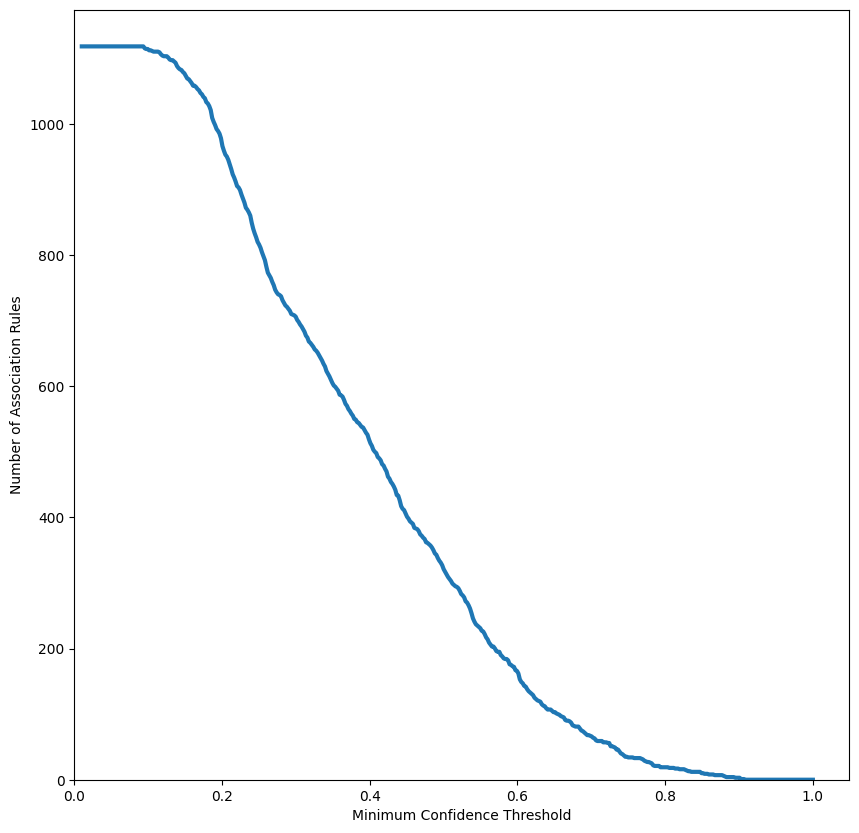

In [42]:
# Plot the number of association rules for more thresholds.
number_of_rules = {
    confidence: len(arule(frequent_itemsets, min_threshold=confidence))
    for confidence in np.linspace(0.01, 1, num=500)
}

fig, ax = plt.subplots(figsize=(10,10))

ax.plot(number_of_rules.keys(), number_of_rules.values(), linewidth=3)

ax.set_ylabel("Number of Association Rules")
ax.set_xlabel("Minimum Confidence Threshold")
ax.set_xlim(left=0)
ax.set_ylim(bottom=0)

**Your answer:**

It can be observed, that the number of association rules converges to $0$ when increasing the minimum confidence threshold.

#### **b(v)** 
From the association rules that satisfy the confidence threshold 0.6, select and show the two rules with the highest lift. What do you notice if you compare the two rules with each other?

In [43]:
highest_lift_i = a_rules_60["lift"].argsort()[::-1][:2]
display(a_rules_60.iloc[highest_lift_i])

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
54,(REGENCY TEA PLATE GREEN),(REGENCY TEA PLATE PINK),0.014576,0.012092,0.010905,0.748148,61.86918,0.010729,3.922574
55,(REGENCY TEA PLATE PINK),(REGENCY TEA PLATE GREEN),0.012092,0.014576,0.010905,0.901786,61.86918,0.010729,10.033411


**Your answer:**

Both rules contain the same two items. One rule describes the possibility that item 2 is contained if item 1 is already chosen and vice versa.

The positive lift values suggest a high correlation between both items.

#### **b(vi)** 

In the analysis tasks in **b)**, an itemset consisted of items that had the same invoice number (same transaction items). Thus, if an itemset was frequent, it meant that the items in it were frequently purchased together.
An association rule $A \Rightarrow B$ meant that if items in $A$ are purchased, then the items in $B$ are also purchased in that same transaction.

Suppose that we would repeat the analysis, but this time, the itemsets would consist of items having the same "CustomerID" (bought from the same customer). Interpret the meaning of the frequent itemsets and association rules for this kind of itemsets.

**Your answer:**

If the itemsets consists of items with the same customer id, the frequent itemsets represent products that are often purchased by the same person (independent from the items they are bought with together during the same purchase).\
In comparison to the itemsets based on the same invoice number, these sets describe common item combinations per person rather than per purchase.

An association rule $A \Rightarrow B$ means that if some person buys items $A$, then the items $B$ are purchased by the same person.

### c) Sequence Mining (3 pts)

For this task, the dataset used is `retail_sequences.csv`. Run the cell below to save the dataset under the dataframe `retail_sequences`. Each row in the dataframe corresponds to a unique customer (from the retail dataset). The "Customer" column contains the customer ID, whereas the "Sequence" column contains the sequence of itemsets  purchased by that customer.  Each value of "Sequence" is a sequence (list) of itemsets $<I_1, I_2, ..., I_n>$. The items within the same itemset (list without duplicates) $I_i$ were purchased together (they had the same invoice number). The itemsets are ordered by the timestamp of the transaction (value of InvoiceDate).

In [44]:
import pandas as pd
retail_sequences = pd.read_csv('datasets/retail_sequences.csv', converters={'Sequence': pd.eval})

Given is the sequence *s= <{'lunch bag cars blue'}, {'herb marker rosemary','herb marker thyme'}, {'wooden star christmas scandinavian'}>*. Compute the support count of that sequence, that is, compute the number of customers whose corresponding itemset sequence contains it. Display its support count and the IDs of those customers.

*Hint: In the dataset provided, all product names are unified. They are all lowercase and have no trailing spaces.*

In [45]:
s = [['lunch bag cars blue'], ['herb marker rosemary', 'herb marker thyme'] ,['wooden star christmas scandinavian']]

In [46]:
s_set = [set(set_) for set_ in s]

from typing import List
def contains_s(customer_seq: List[List[str]]) -> bool:
    customer_seq_sets = [set(set_) for set_ in customer_seq]

    for set_ in s_set:
        found = any([set_ == c_set for c_set in customer_seq_sets])
        if not found:
            return False
    return True

customers = [row["Customer"] for i, row in retail_sequences.iterrows() if contains_s(row["Sequence"])]

print(f'The support count of the sequence is {len(customers)} with the following customers: {customers}')

The support count of the sequence is 0 with the following customers: []


## Question 4: Text Mining (12 pts)

In [47]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from nltk.lm.preprocessing import padded_everygram_pipeline
from nltk.lm import MLE

from sklearn.linear_model import SGDClassifier

import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")
from nltk.tokenize import sent_tokenize, word_tokenize
nltk.download('punkt')
from nltk.stem.wordnet import WordNetLemmatizer
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to /home/cj/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/cj/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/cj/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

### F.R.I.E.N.D.S.

In this task we will use the script from the well-known series "F.R.I.E.N.D.S.". We will apply feature extraction methods to map the line of each main character onto a vector of a vector space. Then we will train a classifier whose aim will be to predict the name of the character given a particular line from the script.
In the end, we will train language models using N-grams and produce fake sentences for each of the main characters.

### a) Data Loading and Preprocessing (4 pts)

#### **a(i)** 
Import the file `FRIENDS.csv` and save it into a dataframe named `friends_df`. Note that the dataframe must contain two columns: one indicating the character's name and one containing a line from the script. Display the first few lines from the dataframe.

<i>FYI: The script has been filtered so that it only contains lines from the main characters. The order of the lines in the data is the same as the order of the lines in the original script. Metadata and scene descriptions have been removed. Your corpus consists of all the lines contained in the data. Each row's "line" value is a single document. </i>

In [48]:
friends_df = pd.read_csv('./datasets/FRIENDS.csv', sep=',')

display(friends_df.head())

,character,line
0,Monica,There's nothing to tell! He's just some guy I...
1,Joey,C'mon you're going out with the guy! There's...
2,Chandler,All right Joey be nice. So does he have a h...
3,Phoebe,Wait does he eat chalk?
4,Phoebe,Just 'cause I don't want her to go through ...


#### **a(ii)**  
Plot the line count distribution among the six main characters (the six possible values of the column "character"). For example, show a plot containing one bar for each character whose height reflects the number of lines in `friends_df`. Briefly comment on the plot.

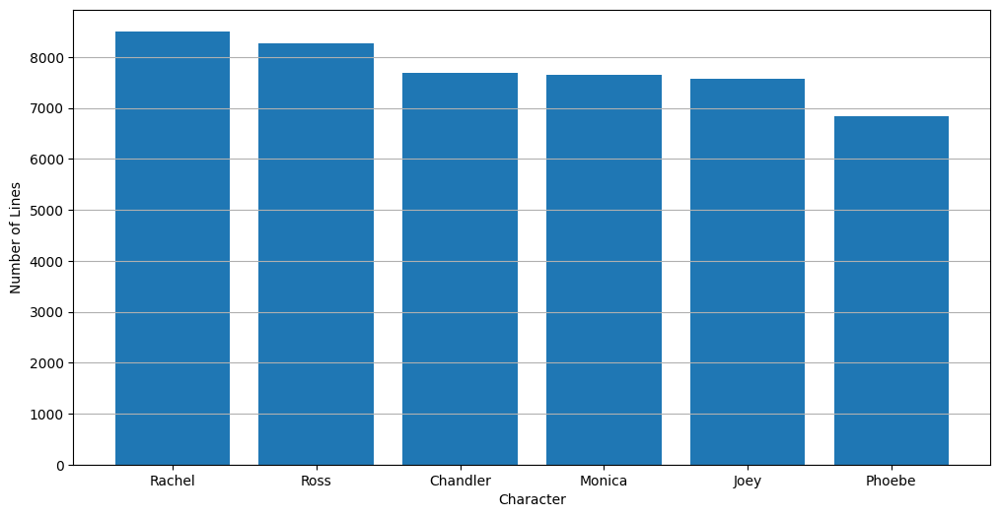

In [49]:
line_counts = friends_df["character"].value_counts()

fig, ax = plt.subplots(figsize=(12,6))

ax.bar(x=line_counts.index, height=line_counts.values)

ax.set_ylabel("Number of Lines")
ax.set_xlabel("Character")
ax.grid(axis="y")

**Your answer:**

The is sorted by the number of lines per character from left to right.

It can easily be recognized that the number of lines for each character lies roughly between $7000$ and $8500$.

#### **a(iii)**  
Create a corpus named `corpus` such that each document in the corpus corresponds to exactly one row's "line" in `friends_df`.

In [50]:
corpus = [TaggedDocument(row["line"], [i, row["character"]]) for i, row in friends_df.iterrows()]

#### **a(iv)**  
Write a function called `my_preprocessor` which, given a string, returns another string after tokenization, stopword removal and lemmatization have been applied. The remaining terms (tokens after stopword removal and lemmatization has been applied) should be joined in the same string using space ' '.

In [96]:
stopword_list = stopwords.words("english")
lemmatizer = WordNetLemmatizer()
def my_preprocessor(line: str) -> str:
    sentences = sent_tokenize(line.strip(" "))
    sentences_as_word_lists = [word_tokenize(sentence) for sentence in sentences]
    words_wo_stopwords = [
        word
        for sentence in sentences_as_word_lists
        for word in sentence
        if word not in stopword_list]
    words = [lemmatizer.lemmatize(word).lower() for word in words_wo_stopwords]
    return ' '.join(words)

#### **a(v)**   
You must apply your preprocessor `my_preprocessor` on each line contained in the `corpus`. Create a preprocessed corpus named `corpus_p` which contains the same lines as `corpus` after the preprocessor `my_preprocessor` has been applied.

In [97]:
corpus_p = [TaggedDocument(my_preprocessor(row["line"]), [i, row["character"]]) for i, row in friends_df.iterrows()]

#### **a(vi)**   
Split the `friends_df` dataset from the previous task into training (80%) and test (20%) data preserving the distribution based on the "character" value. 

In [98]:
characters = friends_df["character"].unique()

train_i = []
test_i = []

for c in characters:
    # Get all indices of the character.
    c_i = [i for i, row in friends_df.iterrows() if row["character"] == c]
    # Create random permutation.
    c_i_r = list(np.random.permutation(c_i))
    # Split at 80% and assign indices to sets.
    split_i = int(len(c_i) * 0.8)
    train_i = train_i + c_i_r[:split_i]
    test_i = test_i + c_i_r[split_i:]

friends_df_train = friends_df.iloc[train_i]
friends_df_test = friends_df.iloc[test_i]

#### **a(vii)**   
Similar to **a(iii)**, for the training data and the test data, create two corpora named `corpus_train` and `corpus_test` respectively. Each document in the training (test) corpus must correspond to exactly one row's "line" value in the corresponding training (test) dataframe.

In [99]:
corpus_train = [TaggedDocument(my_preprocessor(row["line"]), [i, row["character"]]) for i, row in friends_df_train.iterrows()]
corpus_test = [TaggedDocument(my_preprocessor(row["line"]), [i, row["character"]]) for i, row in friends_df_test.iterrows()]

### b) Set of Words (4.5 pts)

#### **b(i)**  
We want to encode our text in such a way that for each word in the vocabulary, we are only interested in whether the word appears or not in a given document. Create such a Set of Words encoding for the whole corpus `corpus`. Use the previously defined preprocessor `my_preprocessor` as preprocessor.

In [100]:
all_words = list(set([word for i in range(len(corpus_p)) for word in corpus_p[i].words.split(" ")]))

def generate_set_of_words(corpus) -> pd.DataFrame:
    return pd.DataFrame(
        data=[
            [word in corpus[i].words for word in all_words]
            for i in range(len(corpus))
        ],
        index=list(range(len(corpus))),
        columns=all_words,
        dtype='bool_'
    )

set_of_words = generate_set_of_words(corpus_p)

#### **b(ii)**  
Pick one (any) of the lines of the "line" column in the `friends_df` dataset. Display the line in:
    1) its original form, 
    2) its preprocessed version (the result contained in `corpus_p` after applying `my_preprocessor`), and 
    3) its encoding computed by the Set of Words method. This can be either an array (a vector) or a scipy matrix. 
Briefly comment on the Set of Words encoding.

In [101]:
print('1) Original:')
display(friends_df.iloc[0]["line"])
print('2) Preprocessed:')
display(corpus_p[0].words)
print('3) Set of Words:')
display(set_of_words.iloc[0])

1) Original:


" There's nothing to tell! He's just some guy I work with!"

2) Preprocessed:


"there 's nothing tell ! he 's guy i work !"

3) Set of Words:


              True
kermit       False
spleeeeen    False
madness      False
sip          False
             ...  
lady         False
schhorry     False
sorry-       False
shoes        False
roll-away    False
Name: 0, Length: 14900, dtype: bool

**Your answer:**

In the set of words encoding, the context of each word and its position in respect to the sentence is lost.

This line is an example where the "'s" behind the word "There" can be identified as the word "is". Without the information on which order the words are, the "'s" could also be behind the word "guy" and would have a different meaning.

#### **b(iii)**  
Create a Set of Words encoding based only on the documents in `corpus_train`. Use the previously defined preprocessor `my_preprocessor` as a preprocessor.

In [102]:
set_of_words_train = generate_set_of_words(corpus_train)

#### **b(iv)**  
In this task, we will use an SGD (Stochastic Gradient Descend) classifier to predict the character given a line from the corpus. Train the classifier on the Set of Words encoding of training corpus `corpus_train` using the character as the target feature and 'log_loss' as the loss function. Apply the classifier on the Set of Words encodings of both the training corpus and the test corpus `corpus_train`. Show its accuracy for both the training corpus and the test corpus.

In [103]:
sgd_clf = SGDClassifier(loss="log_loss")
y_train = [corpus_train[i].tags[1] for i in range(len(corpus_train))]
sgd_clf.fit(set_of_words_train.values, y_train)

SGDClassifier(loss='log_loss')

In [104]:
def accuracy(clf, set_of_words, ty):
    y = clf.predict(set_of_words)
    return np.average(y == ty)

print(f'Accuracy on train corpus: {accuracy(sgd_clf, set_of_words_train.values, y_train)}')

y_test = [corpus_test[i].tags[1] for i in range(len(corpus_test))]
set_of_words_test = generate_set_of_words(corpus_test)
print(f'Accuracy on test corpus: {accuracy(sgd_clf, set_of_words_test.values, y_test)}')

Accuracy on train corpus: 0.41087938077832725
Accuracy on test corpus: 0.2885235332043843


#### **b(v)**  
Briefly comment on the accuracy of the classifier compared to the expected accuracy of a random guesser (here: a model that simply guesses each character according to a distribution based on the line count). Use the line count distribution shown in **a(ii)** to reason about the approximate accuracy of the random guesser.

**Your answer:**

Let $C$ be the set of characters and $n$ be the total number of lines $L$.\
Let $lines: C \to 2^L$ be a function that maps a character $c \in C$ to subset of lines from that character.\

The described random guesser based on the line count distribution would guess that a given line is from character $c$ with a probability of $P(G = c) = \frac{|lines(c)|}{n}$.\
For $|C| = 6$, the expected accuracy of this guesser would be $\frac{1}{6} \approx 0.167$.

Both for the train corpus and the test corpus, the accuracy of the SGD classifier is significantly higher.

#### **b(vi)**  
Pick two lines from the dataset `friends_df`. Predict their character by applying the SGD classifier from **b(iv)** to their Set of Words encodings. Show the original lines, their original characters and the predicted characters.

In [105]:
for i in [0, 1]:
    print(f'- Line {i}:')
    print(corpus[i].words)
    print(f'Character: {corpus[i].tags[1]}')
    print(f'Prediction: {sgd_clf.predict([set_of_words.iloc[i].values])[0]}')

- Line 0:
 There's nothing to tell! He's just some guy I work with!
Character: Monica
Prediction: Chandler
- Line 1:
 C'mon  you're going out with the guy! There's gotta be something wrong with him!
Character: Joey
Prediction: Rachel


### c) Doc2Vec (1.5 pts)

#### **c(i)**  
In this part, we want to encode the lines using Doc2Vec. Create a Doc2Vec embedding based on the documents in the preprocessed corpus `corpus_p`. Set the vector dimension to 10 and min_count to 3.

In [106]:
model = Doc2Vec(corpus_p, min_count=3, vector_size=10)

#### **c(ii)**  
Pick one (any) line from the dataset `friends_df`. Display the line and the character saying it. Find its most similar line w.r.t. the Doc2Vec encoding and display the original line and its corresponding character. Do the lines belong to the same character?

In [107]:
i = 0
print(f'- Line {i}:')
print(corpus[i].words)
print(f'Character: {corpus[i].tags[1]}')

vectors = np.array([model.dv[doc.tags[0]] for doc in corpus])

from scipy.spatial import distance
def vector_distances(i: int) -> np.array:
    return np.array([distance.euclidean(vectors[i], vectors[j]) for j in range(vectors.shape[0])])

nearest = vector_distances(i).argsort()[1]

print(f'- Nearest Line {nearest}:')
print(corpus[nearest].words)
print(f'Character: {corpus[nearest].tags[1]}')

- Line 0:
 There's nothing to tell! He's just some guy I work with!
Character: Monica
- Nearest Line 3223:
 We forgot to sign one of the admissions forms.
Character: Monica


**Your answer:**

The nearest line of the chosen line belongs to the same character.

### d) Language model using N-grams (2 pts)

#### For the following tasks, use the `friends_df` data.

#### **d(i)**  
For each character, create a corresponding corpus. Each corpus must be a list of documents. Each document corresponds to one "line" value of that character and it should be a list of terms. You must obtain this list of terms after applying preprocessing steps such as to lowercase, no punctuation, and tokenization to the original line. Do not perform stemming/lemmatization and/or stopword removal for this task.
Display the corpus of one of the characters.

In [108]:
def my_preprocessor2(line: str) -> List[str]:
    sentences = sent_tokenize(line.strip(" "))
    sentences_as_word_lists = [word_tokenize(sentence) for sentence in sentences]
    words_wo_punctuation = [
        word.lower()
        for sentence in sentences_as_word_lists
        for word in sentence
        if word.isalpha() or word.isnumeric()]
    return words_wo_punctuation

corpi = {
    c: [TaggedDocument(my_preprocessor2(row["line"]), [i]) for i, row in friends_df.iterrows() if row["character"] == c]
    for c in characters
}

display(next(iter(corpi.values())))

[TaggedDocument(words=['there', 'nothing', 'to', 'tell', 'he', 'just', 'some', 'guy', 'i', 'work', 'with'], tags=[0]),
 TaggedDocument(words=['okay', 'everybody', 'relax', 'this', 'is', 'not', 'even', 'a', 'date', 'it', 'just', 'two', 'people', 'going', 'out', 'to', 'dinner', 'not', 'having', 'sex'], tags=[5]),
 TaggedDocument(words=['and', 'they', 'were', 'looking', 'at', 'you', 'before'], tags=[14]),
 TaggedDocument(words=['are', 'you', 'okay', 'sweetie'], tags=[18]),
 TaggedDocument(words=['carol', 'moved', 'her', 'stuff', 'out', 'today'], tags=[21]),
 TaggedDocument(words=['let', 'me', 'get', 'you', 'some', 'coffee'], tags=[23]),
 TaggedDocument(words=['no', 'you', 'do'], tags=[29]),
 TaggedDocument(words=['oh', 'really', 'so', 'that', 'hysterical', 'phone', 'call', 'i', 'got', 'from', 'a', 'woman', 'at', 'sobbing', 'i', 'never', 'have', 'grandchildren', 'i', 'never', 'have', 'grandchildren', 'was', 'what', 'a', 'wrong', 'number'], tags=[35]),
 TaggedDocument(words=['rachel'], tags

#### **d(ii)**  
For each character separately, build a trigram language model using MLE. Use both right and left padding and learn each language model using the character's corpus from **d(ii)**.

In [109]:
lms = {
    c: MLE(3)
    for c in characters
}

for c in characters:
    lm = lms[c]
    text = [doc.words for doc in corpi[c]]
    train, vocab = padded_everygram_pipeline(3, text)
    lm.fit(train, vocab)

#### **d(iv)**  
For each character, use the created trigram language model to generate a sentence of ten words. Display the sentences.

In [123]:
for c in characters:
    line = lms[c].generate(10)
    print(f'{c}: {line}')

Monica: ['<s>', '<s>', 'so', 'you', 'gave', 'her', 'the', 'truth', '</s>', '</s>']
Joey: ['dying', 'out', 'so', 'i', 'just', 'i', 'wan', 'na', 'wish', 'him']
Chandler: ['oh', 'god', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>']
Phoebe: ['wow', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>']
Ross: ['about', 'to', 'be', 'there', '</s>', '</s>', '</s>', '</s>', '</s>', '</s>']
Rachel: ['100', 'degrees', 'outside', 'for', 'the', 'wedding', 'was', 'all', 'i', 'kept']


## Question 5: Process Mining (22pts)

In [66]:
import pandas as pd
import pm4py

In [67]:
from pm4py.statistics.traces.generic.log import case_statistics

In [68]:
from pm4py.algo.conformance.tokenreplay import algorithm as token_based_replay

In [69]:
import matplotlib.pyplot as plt

### a) Loading the Data and Basic Statistics (9pts)

#### **a(i)** 
Load the data **reimburse.csv** and create a PM4Py event log. In doing so, use the following column mapping:
 - *Activity* is the activity key
 - *Case* is the case ID
 - *Timestamp* is the timestamp

In [70]:
reimburse_df = pd.read_csv('./datasets/reimburse.csv', sep=',')
reimburse_df = pm4py.format_dataframe(reimburse_df, case_id='CaseId', activity_key='Activity', timestamp_key='Timestamp')
event_log = pm4py.convert_to_event_log(reimburse_df)

/tmp/ipykernel_29496/474768886.py:2: DeprecatedWarning:

format_dataframe is deprecated as of 2.3.0 and will be removed in 3.0.0. the format_dataframe function does not need application anymore.



#### **a(ii)** 
Compute and print the following basic information:
- Number of events
- Number of cases
- Earliest timestamp
- Latest timestamp
- Number of trace variants

In [71]:
print(f'Number of events: {reimburse_df.shape[0]}')
print(f'Number of cases: {reimburse_df["CaseId"].unique().size}')
timestamps = pm4py.get_event_attribute_values(event_log, "time:timestamp")
timestamps_keys = sorted(timestamps.keys())
print(f'Earliest timestamp: {timestamps_keys[0]}')
print(f'Latest timestamp: {timestamps_keys[-1]}')
variants = pm4py.get_variants(event_log)
print(f'Number of trace variants: {len(variants)}')

Number of events: 47830
Number of cases: 10000
Earliest timestamp: 2020-06-01 06:00:00+00:00
Latest timestamp: 2022-03-10 12:14:51+00:00
Number of trace variants: 266


#### **a(iii)** 
In process mining, multiple events that have the same timestamp can cause problems because the ordering of events (or even activities) becomes unclear. Moreover, they can indicate batching (i.e., one activity is executed for multiple cases simultaneously). Therefore, during your analysis, it is good to keep that in mind. To this end, compute the following statistics/answer the following questions:

1. How many events occur almost at the same time (i.e., within less than 100ms as the preceding event. (Proceeding event in the *entire* event log)?
2. Are there resources that complete two activities at the same time (within less than 100ms)?
3. How many cases are there in which two activities are executed at the same time (i.e., two events that belong to the same case occur within less than 100ms)?

*Hint: Depending on how you find the answers, be careful about event orderings.*

In [72]:
# 1. Find number of events occurring at the same time: As the timestamps are encoded in seconds, the number of events within less than 100ms is the number of events with a timestamp that is present at another event.
print(f'Events occuring at the same time: {sum([number for number in timestamps.values() if number > 1])}')

# 2. Resources that complete two activities at the same time.
resources = pm4py.get_event_attribute_values(event_log, "Resource")
for resource in resources.keys():
    resource_log = pm4py.filter_log(lambda t: any(map(lambda e: e["Resource"] == resource, t)), event_log)
    res_timestamps = pm4py.get_event_attribute_values(resource_log, "time:timestamp")
    same_time = sum([number for number in res_timestamps.values() if number > 1])
    if same_time > 0:
        print(f'Resource {resource} contains {same_time} activities completed at the same time.')

# 3. Number of cases where two activities are executed at the same time.
cases = pm4py.get_event_attribute_values(event_log, "@@case_index")
for case in cases.keys():
    case_log = pm4py.filter_log(lambda t: any(map(lambda e: e["@@case_index"] == case, t)), event_log)
    case_timestamps = pm4py.get_event_attribute_values(case_log, "time:timestamp")
    same_time = sum([number for number in case_timestamps.values() if number > 1])
    if same_time > 0:
        print(f'Case {case} contains {same_time} activities completed at the same time.')

Events occuring at the same time: 1098
Resource 111 contains 1098 activities completed at the same time.
Resource 1 contains 1015 activities completed at the same time.
Resource 2 contains 735 activities completed at the same time.
Resource 5 contains 291 activities completed at the same time.
Resource 20 contains 157 activities completed at the same time.
Resource ~1 contains 4 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:7: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:7: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:7: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:7: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:7: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:7: DeprecatedWarning:

filter_log is deprecated as of 2

Case 397 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 500 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 1215 contains 2 activities completed at the same time.
Case 1231 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 1733 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 5492 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 5556 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 5863 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 6019 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 6052 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 6231 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 6294 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 6357 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 6518 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 6586 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 7055 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 7293 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 7499 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 7722 contains 2 activities completed at the same time.
Case 7731 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

Case 8679 contains 2 activities completed at the same time.


/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated as of 2.3.0 and will be removed in 3.0.0. the EventLog class will be removed in a future release.

/tmp/ipykernel_29496/1667210961.py:16: DeprecatedWarning:

filter_log is deprecated a

#### **a(iv)** 
Provide a plot that shows the number of running cases (i.e., cases that have started but not yet finished) over time. You may assume that the log only contains complete traces. For each case that has started, its completion is the last observed event associated with that case. In case multiple cases start or end at the same time, you also generate multiple values.

In [73]:
# TODO

**Your answer**: *(Briefly describe the differences between the two models in about five sentences here.)*

### b) Discovery and Conformance Checking (9pts)

#### **b(i)** 
Mine a Petri net using Inductive Miner and display it.

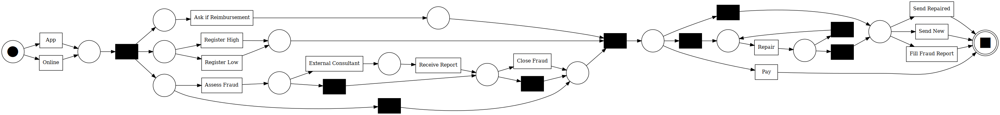

In [74]:
net, im, fm = pm4py.discover_petri_net_inductive(event_log)
pm4py.view_petri_net(net, im, fm, format='png') 

#### **b(ii)** 
Compute the fitness of the discovered Petri net using token-based replay.

*Hint: PM4Py can directly (using the top-level API) compute the number of missing, remaining, consumed, and produced tokens. Based on these, you can, for example, compute the token-based replay fitness.*

In [75]:
replay = token_based_replay.apply(event_log, net, im, fm)

fitness = np.average([x["trace_fitness"] for x in replay])
print(f'Trace fitness:  {fitness}')

replaying log with TBR, completed variants ::   0%|          | 0/266 [00:00<?, ?it/s]/home/cj/_Files/Documents/University/22WS/3 IDS/Assignments/venv/lib/python3.10/site-packages/pm4py/algo/conformance/tokenreplay/variants/token_replay.py:485: DeprecatedWarning:

enabled_transitions is deprecated as of 2.3.0 and will be removed in 3.0.0. this method will be removed

/home/cj/_Files/Documents/University/22WS/3 IDS/Assignments/venv/lib/python3.10/site-packages/pm4py/objects/petri_net/semantics.py:196: DeprecatedWarning:

is_enabled is deprecated as of 2.3.0 and will be removed in 3.0.0. this method will be removed, use PetriNetSemantics.is_enabled() instead

/home/cj/_Files/Documents/University/22WS/3 IDS/Assignments/venv/lib/python3.10/site-packages/pm4py/objects/petri_net/semantics.py:196: DeprecatedWarning:

is_enabled is deprecated as of 2.3.0 and will be removed in 3.0.0. this method will be removed, use PetriNetSemantics.is_enabled() instead

/home/cj/_Files/Documents/University/22

Trace fitness:  1.0


#### **b(iii)** 
Filter the log to contain only traces where *Register Low* occurs. How many traces does the resulting log `log_low` contain?


In [76]:
# TODO

#### **b(iv)** 
Discover a Petri net for `log_low` and compute its fitness. How does this model differ from the model you discovered in *b(i)*? 

Suppose each of your produced process models is considered a 2-class classifier: provided a trace, it returns "Yes" if and only if the trace can be replayed by the model. Based on this perspective, how would the two process models compare in terms of precision?

In [77]:
# TODO

**Your answer:** *(Briefly describe the difference between the two models here. About two sentences can be enough.*)

**Your answer**: *(Relate your observations to precision here.)*

### Conformance Diagnostics De-jure Model
The process owner provides you a de-jure model (i.e., a model of the should-be process) and a slightly changed version of the so far considered event log. 

In this task, you will again apply conformance checking by means of token-based replay to provide diagnostics on deviations.

#### **b(v)** 
Load the Petri net *pn_conf.apnml*, the event log *log_conf.xes*, and provide the overall (i.e., model-based) token-based replay fitness score.



In [78]:
# TODO

#### **b(vi)** 
To provide additional diagnostics on the deviations, compute the missing, consumed, produced and remaining number of tokens for **each place**. 
To do so, use the following *pm4py* code:
    
    from pm4py.algo.conformance.tokenreplay import algorithm as token_based_replay
	tbr_results, place_fitness, transition_fitness, notexisting_activities_in_model =
    token_based_replay.apply(log_conf, net_conf, im_conf, fm_conf, parameters={"enable_pltr_fitness": True, "disable_variants": True})

After running this line for log `log_conf`, Petri net `net_conf` with initial marking `im_conf` and final marking `fm_conf`, the variable `place_fitness` will contain the token counts for each place and trace. Therefore, you will only need aggregate over the traces.
Print a table of the token counts per place. 


In [79]:
# TODO

#### **b(vii)** 
Consider the token counts per place and a few unfitting traces, which deviation(s) do you observe? Describe the deviation and briefly explain how it can be related to the token counts of the individual places. For example, activity *xy* is often missing resulting in a high number of missing tokens in place *p*.  


In [80]:
# TODO

**Your answer:** *(Describe the deviation(s). One sentence can already be enough.)*

**Your answer:** (*Relate the deviation(s) to the token counts of the individual places. Roughly five sentences can be enough for a precise description.*)

### c) Analyzing Fraud (4pts)

#### **c(i)** 
Filter the event log so that it only contains traces where a fraud report is filled (occurrence of `Fill Fraud Report`). For theses traces, create a bar plot showing the number of products of a certain brand involved in the fraud. Describe the resulting plot.

*Hint: Each case is associated with precisely one brand.*


In [81]:
# TODO

**Your answer:** (*Describe the plot in two to three sentences.*)

#### **c(ii)**  
The plot shows differences between brands. Discuss the result. Consider what you learned in Lecture 11 (association rules). Try to provide additional analysis results to underpin your discussion.

*Hint: A very short additional analysis (i.e., a few lines of code) might already be sufficient.*


In [82]:
# TODO

**Your answer:** *(Relate your results to Lecture 11, approximately one short paragraph)*

## Question 6 - Simpson's Paradox (3 pts)

### Sex Bias in Berkeley Graduate Admissions?

In the Fall of 1973, the University of California at Berkeley released data about their graduate class. The data showed the major the applicant applied to, their self-reported gender (Male or Female), and whether or not they were accepted or rejected. The acceptance rates between men and women were different. This caused immediate concern in the public as people thought that Berkeley was biased against women.

The "Berkeley Dataset" contains all 12,763 applicants to UC-Berkeley's graduate programs in Fall 1973. This dataset was published by UC-Berkeley researchers in an analysis to understand the possible gender bias in admissions.

Dataset Variables:

Year : number ➜ The application year (this value is always 1973)

Major : string ➜: An anonymized major code (either A, B, C, D, E, F, or Other). The specific majors are unknown except that A-F are the six majors with the most applicants in Fall 1973

Gender : string ➜ Applicant self-reported gender (either M or F)

Admission: string ➜ Admission decision (either Rejected or Accepted)

**a)**
Upload the data from the `berkeley.csv` file and load it into a dataframe named `data`. Display the first few lines from the dataframe.

In [83]:
data = pd.read_csv('./datasets/berkeley.csv', sep=',')

display(data.head())

,Year,Major,Gender,Admission
0,1973,C,F,Rejected
1,1973,B,M,Accepted
2,1973,Other,F,Accepted
3,1973,Other,M,Accepted
4,1973,Other,M,Rejected


**b)** Remove the "Year" column as it does not contain any information in this dataset (all years are 1973.)

In [84]:
data.drop(columns=["Year"], inplace=True)

**c)** For each of the values of column "Gender", compute the admission rate and compare them against each other.

In [85]:
def admission_rate(df: pd.DataFrame) -> float:
    if df.size == 0:
        return None
    rate = df[df["Admission"] == "Accepted"].shape[0] / df.shape[0]
    return round(rate, 4)

for gender in data["Gender"].unique():
    print(f'{gender}: {admission_rate(data[data["Gender"] == gender])}')

F: 0.3458
M: 0.4428


**Your answer:**

The overall admission rate for people with the self-reported gender "Female" is significantly lower than that of the people with the self-reported gender "Male".

**d)** For each value combination of the "Gender" and "Major" columns, compute the admission rate. Compare the admission rate of women against the admission rate of men for each of the majors.

In [86]:
admission_rates = {
    gender: list()
    for gender in data["Gender"].unique()
}

for major in data["Major"].unique():
    data_m = data[data["Major"] == major]
    for gender in data["Gender"].unique():
        data_g = data_m[data_m["Gender"] == gender]
        admission_rates[gender].append(admission_rate(data[data["Major"] == major][data["Gender"] == gender]))

display(pd.DataFrame(
    data=admission_rates,
    index=data["Major"].unique()
))

,F,M
C,0.3390,0.3692
B,0.6800,0.6304
Other,0.3769,0.4095
F,0.0733,0.0590
A,0.8241,0.7250
D,0.3493,0.3309
E,0.2392,0.2775


**Your answer:**

For the majors "B", "F", "A" and "D" the admission rate of people with the self-reported gender "Female" is higher.\
For the other majors ("C", "Other", and "E") the admission rate of people with the self-reported gender "Male" is higher.

**e)** Can you confirm there is a sex bias in the admission rates of the students?

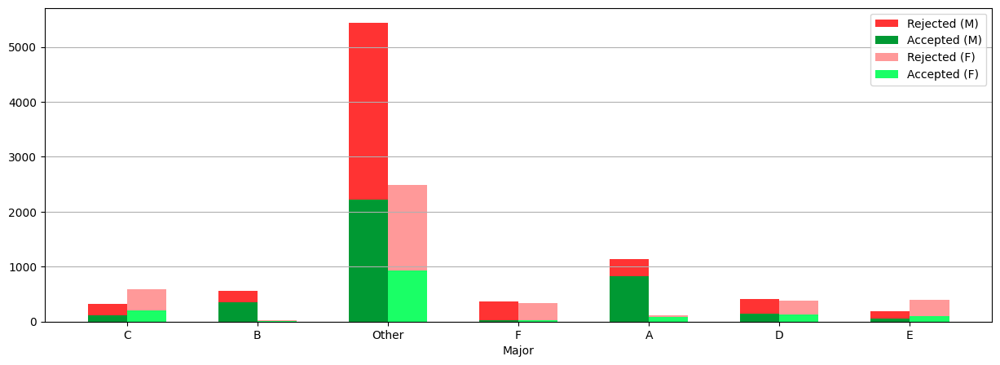

In [87]:
fig, ax = plt.subplots(figsize=(15,5))

majors = data["Major"].unique()
majors_i = np.arange(majors.size)

data_m = data[data["Gender"] == "M"]
data_f = data[data["Gender"] == "F"]

data_m_a = data_m[data_m["Admission"] == "Accepted"]
data_f_a = data_f[data_f["Admission"] == "Accepted"]

m = [data_m[data_m["Major"] == major].shape[0] for major in majors]
f = [data_f[data_f["Major"] == major].shape[0] for major in majors]

m_a = [data_m_a[data_m_a["Major"] == major].shape[0] for major in majors]
f_a = [data_f_a[data_f_a["Major"] == major].shape[0] for major in majors]

ax.bar(majors_i - 0.15, m, 0.3, label='Rejected (M)', color="#ff3333")
ax.bar(majors_i - 0.15, m_a, 0.3, label='Accepted (M)', color="#009933")
ax.bar(majors_i + 0.15, f, 0.3, label='Rejected (F)', color="#ff9999")
ax.bar(majors_i + 0.15, f_a, 0.3, label='Accepted (F)', color="#1aff66")

ax.set_xticks(majors_i)
ax.set_xticklabels(majors)
ax.set_xlabel('Major')
ax.grid(axis='y')
ax.legend(loc='upper right')

In [88]:
# Probability of choosing a major independent from gender.
def p_choice_major(major: str) -> float:
    data_m = data[data["Major"] == major]
    return data_m.shape[0] / data[data["Major"] != "Other"].shape[0]

# Probability of an admission based on gender and major.
def p_admission(major: str, gender: str) -> float:
    data_g = data[data["Gender"] == gender]
    data_g_m = data_g[data_g["Major"] == major]
    return admission_rate(data_g_m)

for gender in data["Gender"].unique():
    admission_prop = sum([p_choice_major(major) * p_admission(major, gender)
                          for major in data["Major"].unique() if major != "Other"])
    print(f'\nProbability of admission for gender "{gender}" assuming the probability of the choice of a specific major is independent from gender:\n{round(admission_prop, 4)}')


Probability of admission for gender "F" assuming the probability of the choice of a specific major is independent from gender:
0.4556

Probability of admission for gender "M" assuming the probability of the choice of a specific major is independent from gender:
0.4293


**Your answer:**

In the generated plot, it can be observed that the applied majors are not equally distributed amongst the self-reported genders.\
Thus, from the viewpoint of probability theory, the events "Choice of Major" and "Gender" can not be assumed to be independent of each other.

This dependence of events means that the real overall probability of admission for a specific person can **not** be obtained by combining the probability (1) of the person choosing some major $X$ considering their gender and the probability (2) of the application of that person being accepted considering the chosen major _and_ and their gender.\
(Which would yield the same results as the admission rates calculated in subsection **c)**.)

To obtain the probability that a person with a the self-reported gender $Y$ is accepted into their preferred major, we assume that the choice of major is independent from gender:\
We can consider the probability that an applicant of _any_ gender chooses Major $X$ as
$P_{\text{Major Choice}}(M=X) = \frac{|\text{Applications for Major }X|}{|\text{Applications}|}$.

The probability that this person (with gender $Y$, applying for major $X$) is then accepted is
$P_{M}(A = "Accepted"\ |\ G = Y) = \frac{|\text{Accepted Applications for Major } X \text{ by Gender } Y|}{|\text{Applications for Major } X \text{ by Gender } Y|}$

Thus, the overall probability of a person with gender $Y$ to be accepted is:\
$P(A = "Accepted"\ |\ G = Y) = \sum_{X \in Majors} P_{\text{Major Choice}}(M=X) \cdot P_{X}(A = "Accepted"\ |\ G = Y)$

Applying this to the given data while ignoring major "Other", we get the probability of admission for both genders under the assumption that the choice of major does not depend on the gender. It can be observed, that the overall admission probability for a person with the self-reported gender "Female" is slightly higher.

It is important to note, that it is not possible to either confirm or deny any "sex bias" from the given data, neither from the admission rates per major, nor from the calculated probability.
This is the case because the data does not contain any information about the decision process to accept or reject an application.

## Question 7: Big Data (15pts)

In [89]:
import pandas as pd

You are a data scientist at NASA, an agency for civil space programs, and with your team you develop and maintain the software of the NASA Crew Exploration Vehicle (CEV).  Your task is to analyze the performance of the software, and as a first exploratory step, you would like to **compute the mean execution times** of function calls within that software. Since the running vehicle will generate a high throughput of observable events in a stream, you decide to set up a MapReduce pipeline in Hadoop. 

The file **nasa-cev-software-tests.tsv** records timestamped events of the vehicle's software tests. The log contains the columns *Case*, *Activity* and *Timestamp*, denoting the case ID, the activity key (method call) and timestamp of the event record in nanoseconds, respectively. Furthermore, the log contains the columns *Lifecycle Transition* and *Execution ID*. The lifecycle transition takes either of the values *start* and *complete*, stating whether the corresponding activity (method call) in that row is being started or completed at the specified timestamp. The execution ID relates each event to a concrete method call, i.e., for each execution ID, there are exactly two entries (namely a *start* and a *complete* event) in the log.

### a) Plan the Maths (2pt):

The mean $\mu_n$ over numerical values $v_1,...,v_n$ is well-known to be computed as $\mu_n = \frac{1}{n}\sum_{i=1}^{n} v_i$.\
One may also use the alternative recursive formalization $\mu_{n+m} = \frac{n\cdot\mu_{n} + m\cdot\mu_{m}}{n+m}$. \
What is the advantage of using the alternative formalization when you think of handling streaming data or distributed data? Briefly explain.


**Your answer:**

Using the recursive formalization allows to calculate the mean without knowing the exact values for every previous value.\
When computing the mean with the sum, we need all values $v_i$. With the recursive approach, we only need $n$ and $\mu_n$ of all previous values.\
This is a big advantage when handling streaming data or distributed data, as we don't want to compute the mean over a finite set of local values, but over flexible set of values containing incoming and past data.

### b) Set up MapReduce (10pts)

Realize the computation of the mean execution times of activities as a MapReduce job. 
You need to implement this a cascaded MapReduced job. This means that the output of the first job will serve as the input of the second job. In the first job, derive the execution times of each activity execution, i.e. the time difference between the *complete* and the *start* lifecycle transition of each activity execution. In the second step, aggregate this timing information to compute the mean.

#### **b(i)** 
Specify the *function signatures* of the map functions and the reduce functions that you are going to use.\
I.e., find concrete sets to substitute $K_1, V_1, ... $ in the general signatures for map and reduce functions \

$ map:  K_1 \times V_1 \rightarrow (K_2 \times V_2)^* $\
$ reduce: K_2 \times (V_2)^* \rightarrow (V_3)^*$ (or a singleton $V_3$) 

*Hint: You may introduce symbols to denote sets, e.g. $Act$ for the set of activities.\
You may also first implement the solution (b(ii)) to get an idea about the underlying signatures.\
Mind that you need two map and two reduce functions.*

**Your answer:**

Let $Index$ be the set of indices from the event log and $Events$ be the corresponding lines.\
Let $EID$ be the set of execution ids.\
Let $Act$ be the set of activities.\
Let $TS$ be the set of possible timestamps.\
Let $Dur$ be the set of possible durations (difference between timestamps)\
Let $AvgDur$ be the set of possible averages of durations.

First job:\
Extract the durations for each execution from a given event log.

$K_1 = Index$, $V_1 = Events$\
$K_2 = Act \times EID$, $V_2 = TS$, $V_3 = Dur$

$map_1: Index \times Events \to (Act \times EID) \times TS$\
$reduce_1: (Act \times EID) \times (TS)^* \to Dur$

Second job:\
Calculate the average duration for each activity.

$K_1 = Act \times EID$, $V_1 = Dur$\
$K_2 = Act$, $V_2 = Dur$, $V_3 = AvgDur$

$map_2: (Act \times EID) \times Dur \to Act \times Dur$\
$reduce_2: Act \times (Dur)^* \to AvgDur$


#### **b(ii)**: 
Specify map functions and reduce functions to compute the mean execution time per activity as python scripts.

In [ ]:
#!/usr/bin/env python
import sys


def map_1_get_timestamp(_, line):
    # Extract info from tvs-line.
    (activity, ts, _, eid) = line.split("\t")
    # Map line to Key (execution id, activity) and value timestamp.
    return (eid, activity), ts


for line in sys.stdin:
    # Strip line.
    line = line.strip()
    # Apply mapper.
    (eid, activity), ts = map_1_get_timestamp(None, line)
    # Return key value pairs in tvs format with a custom separator for the key-
    # tuple.
    print(eid+"KEY_SEPARATOR"+activity+"\t"+ts)


In [ ]:
#!/usr/bin/env python
import sys


def reduce_1_get_duration(key, timestamps):
    # Calculate difference between both timestamps.
    dur = abs(timestamps[0]-timestamps[1])
    return key, dur


# Save a list of timestamps per key in a dict.
timestamps_by_key = dict()

for kv in sys.stdin:
    # Strip line and extract values.
    key, timestamp = kv.strip().split("\t")
    # Check if a list already exists for the key.
    found = timestamps_by_key.get(key)

    if found is not None:
        found.append(int(timestamp))
    else:
        timestamps_by_key[key] = [int(timestamp)]

for key, timestamps in timestamps_by_key.items():
    # For every key and the corresponding time stamps, apply the reducer.
    key, dur = reduce_1_get_duration(key, timestamps)

    print(key+"\t"+str(dur))


In [ ]:
#!/usr/bin/env python
import sys


def map_2_by_activity(key, dur):
    # Extract activity from key-tuple.
    (_, activity) = key.split("KEY_SEPARATOR")

    return activity, dur


for line in sys.stdin:
    # Strip line and extract key-value pair.
    key, dur = line.strip().split("\t")
    # Apply mapper.
    activity, dur = map_2_by_activity(key, dur)

    print(activity+"\t"+dur)


In [ ]:
#!/usr/bin/env python
import sys


def reduce_2_average(activity, durs):
    # Calculate average duration.
    average_dur = sum(durs) / float(len(durs))

    return activity, average_dur


# Save a list of durations per activity in a dict.
durs_by_activity = dict()

for kv in sys.stdin:
    # Strip line and extract key-value pair.
    activity, dur = kv.strip().split("\t")
    # Check if a list already exists for the activity.
    found = durs_by_activity.get(activity)

    if found is not None:
        found.append(int(dur))
    else:
        durs_by_activity[activity] = [int(dur)]

for activity, durs in durs_by_activity.items():
    # For every activity and the corresponding durations, apply the reducer.
    activity, average_dur = reduce_2_average(activity, durs)

    print(activity+"\t"+str(average_dur))


### c) Run MapReduce (3pts)

In the following, please use one of your team members' matriculation number as an identifier.

#### **c(i) (Randomization)**: 
Before applying your functions from the previous step to the dataset, please insert the matriculation number and run the following lines to randomly filter out a few of the traces in the event log, and continue working with the filtered log. 


In [90]:
# your matriculation number here
matr_nb = 395359

# utility code (do not change)
import random
random.seed(matr_nb)

full_df = pd.read_csv("datasets/nasa-cev-software-tests.tsv", sep="\t")

case_ids = list(set(full_df["Case"].values))
case_ids.sort()
filtered_out_case_ids = random.sample(case_ids, 10)
filtered_case_ids = [case_id for case_id in case_ids if case_id not in filtered_out_case_ids]
randomized_df = full_df[full_df["Case"].isin(filtered_case_ids)]

randomized_df.to_csv("datasets/nasa-cev-software-tests-randomized-" + str(matr_nb) + ".tsv",
          columns=["Activity", "Timestamp", "Lifecycle Transition", "Execution ID"],
          sep="\t", index=False, header=False)

#### **c(ii)**:
Now, it is time to work with the Hadoop Distributed File System (HDFS). Follow the instructions below and show your results in each step (screenshots of the command line).

    1) Import the event log to your Docker engine (at /usr/local/hadoop/(your_matr_nb)-event-log/). You also need to import the python scripts, but only document the event log import here.
    2) Upload the files to the running HDFS (at /input/(your_matr_nb)-event-log/).
	3) Run Hadoop commands for the MapReduce computation.
    4) Show the final output (computed mean execution times).

In [91]:
from IPython.display import Image

**1)**

After the docker container is created and started, the input file is copied into it.

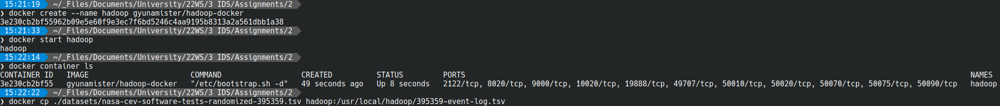

In [92]:
display(Image(filename='./screenshots/1_import.png'))

**2)**

An input directory is created on the hadoop filesystem where the event log is then uploaded.

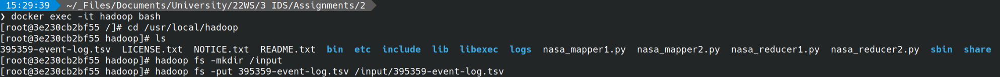

In [93]:
display(Image(filename='./screenshots/2_upload.png'))

**3)**

As the job is separated into two cascaded MapReduce programs, the first program is executed on the input file (`/input/395359-event-log.tsv`) while the second program is executed on the output file of the first program (`/output_1/part-00000`).

**Note:**

Because the output log of each hadoop run is so long that it does not even fit into two screenshots, the full logs can be found as text files (`screenshots/execution_1.txt` and `screenshots/execution_2.txt`) in the screenshot archive.

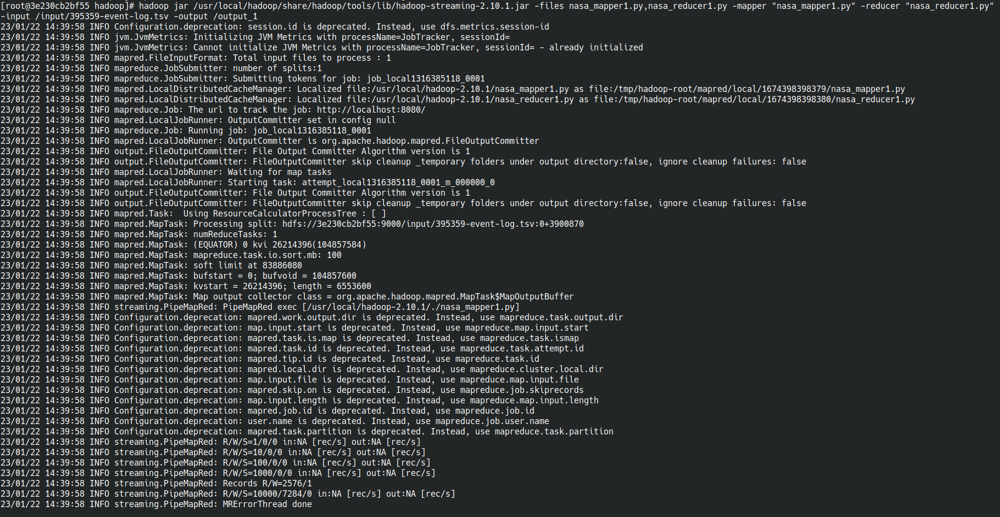

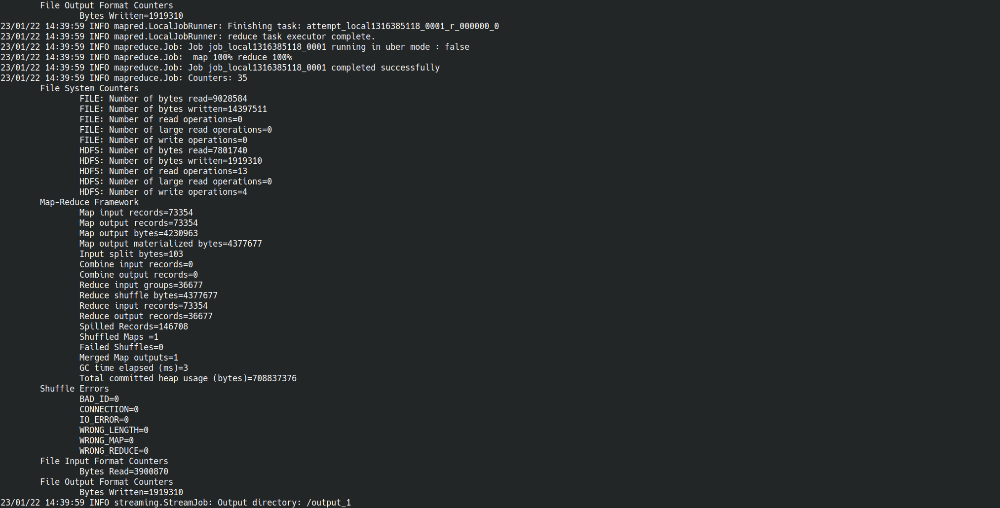

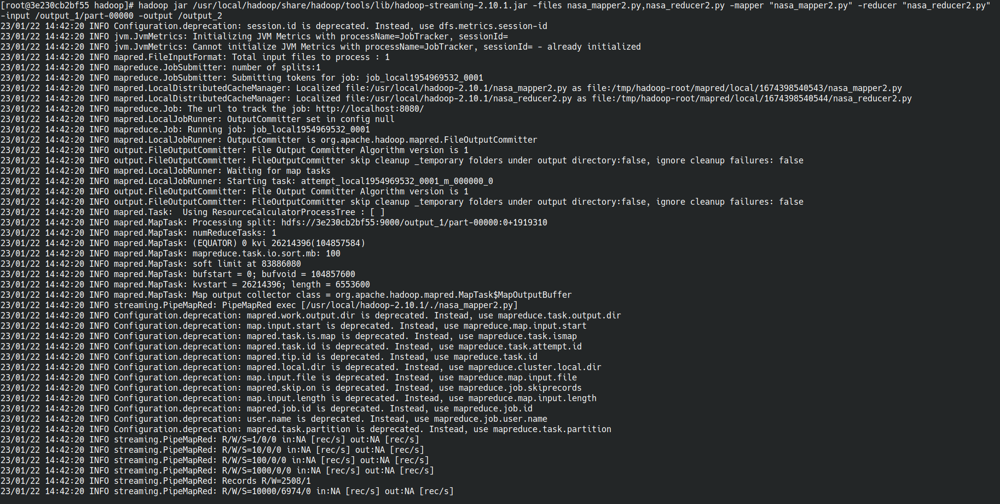

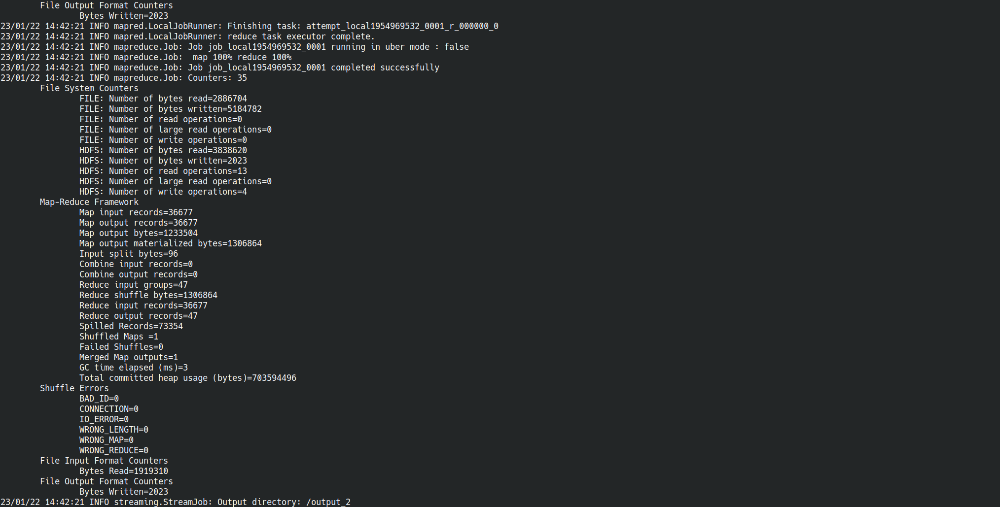

In [94]:
display(Image(filename='./screenshots/3_run_1_1(top).png'))
display(Image(filename='./screenshots/3_run_1_2(bottom).png'))
display(Image(filename='./screenshots/3_run_2_1(top).png'))
display(Image(filename='./screenshots/3_run_2_2(bottom).png'))

**4)**

Finally, the output of the second program can be downloaded from the hadoop filesystem.

**Note:**

Similar to step 3), the output files (of both programs) can be found in the screenshot archive as tsv-files (`screenshots/output_1.tsv` and `screenshots/output_2.tsv`).

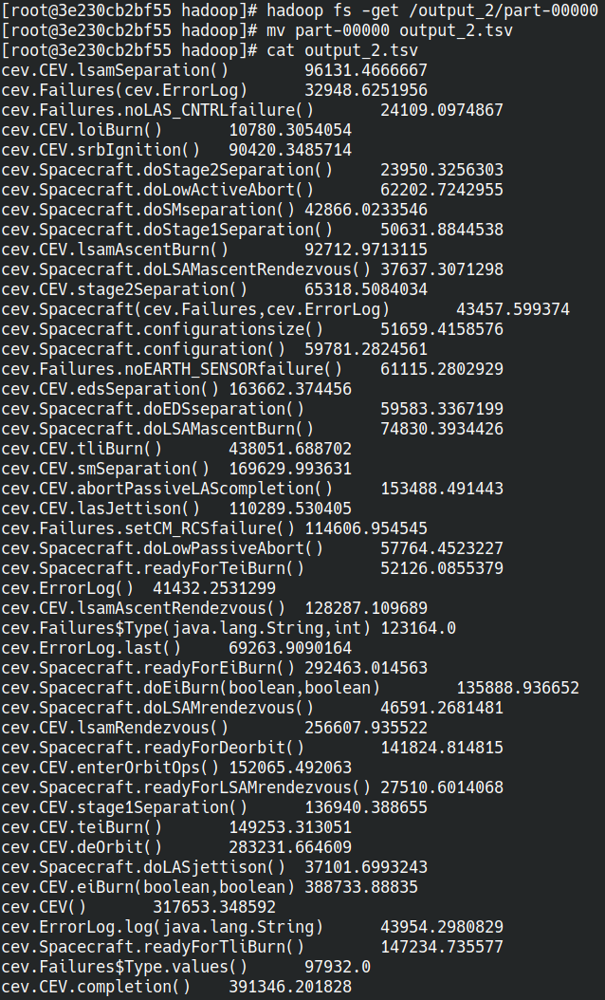

In [95]:
display(Image(filename='./screenshots/4_output.png'))